# 0. Imports

In [1]:
import numpy as np
import pandas as pd
from pandas import DataFrame as dataframe
import matplotlib.pyplot as plt
import seaborn as sns
import os
from os.path import join
from tqdm import tqdm

from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split


from matplotlib.colors import ListedColormap, LinearSegmentedColormap

import pickle

In [2]:
print(os.getcwd())
base_dir = os.getcwd()

paths={
    'data': join(base_dir, 'data'),
    'processed': join(base_dir, 'processed'),
    'datasets': join(base_dir, 'datasets1'),
    'amexplorer': join(base_dir, 'datasets1', 'amexplorer', 'raw'),
    # 'binaries': join(base_dir,'datasets1', 'binaries'),
    # 'continuous': join(base_dir,'datasets1', 'continuous'),
    # 'limpos': join(base_dir,'datasets1', 'limpos'),
    'models': join(base_dir,'models'),
    'images': join(base_dir,'imgs'),
    'shap': join(base_dir,'shap'),
    'files': join(base_dir,'files'),
    
}

D:\github


In [68]:
def plot_importance(model, feature_names, threshold=0.01, figsize=(4, 3)):
    fig= plt.figure(figsize=figsize)
    feature_names = np.asarray(feature_names)
    indices = np.argsort(model.feature_importances_)
    importance = dataframe({'features':feature_names[indices], 'values': model.feature_importances_[indices]})
    importance = importance[::-1].reset_index(drop=True)
    sns.barplot(data=importance[importance['values']>threshold],
           y='features', x='values',
           orient= 'h')

    plt.xlabel('Feature Importance Score')
    plt.ylabel('Features')
    plt.title("Visualizing importance scores")
    plt.yticks(fontsize=6)
    # plt.legend(xg_model.classes_)
    plt.show()
    return importance

def shap_explainer(model, X, y, explainer_name='Explainer'):
    explainer = []
    if explainer_name=='Explainer':
        explainer = shap.Explainer(model, X)
    elif explainer_name=='DeepExplainer':
        explainer = shap.DeepExplainer(model, X)
    elif explainer_name=='TreeExplainer':
        explainer = shap.TreeExplainer(model, X)
    
    shap_values = explainer(X)
    return explainer, shap_values

def process_column(column_names, delimiter='.'):
    process_col = [col.strip().replace(';','.').replace(',','.').replace(':','.').replace('->','').replace('/','.').replace(' ', '_').lower() for col in column_names]

    return [col.split(delimiter)[-1] for col in process_col]

def plt_summary_custom(shap_values, X, max_display, feature_names, 
                       figsize=(5,3), path_save=[], title='beeswarm',
                       plot_type = 'bar'):
    #  plot_type = 'bar', 'dot', 'violin'
    
    cmap = LinearSegmentedColormap.from_list("", ["skyblue","indianred"])
    shap.summary_plot(shap_values, X, feature_names=feature_names, 
                      max_display=max_display, plot_size=figsize, cmap = cmap,
                      plot_type = plot_type, show=False, 

                     )
    plt.yticks(fontsize=6)
    plt.tight_layout()
    plt.ylabel('Features' , fontsize=10)
    plt.xlabel('SHAP values impact on model output', fontsize=10)
    if path_save: 
        plt.savefig(join(path_save, title+'_shap_summary_'+plot_type+'.pdf'), format='pdf', dpi=512, bbox_inches='tight')
    plt.show()

    return 

def plt_beeswarm_custom(shap_values, max_display, figsize=(5,3), path_save=[], title='beeswarm'):
    cmap = LinearSegmentedColormap.from_list("", ["skyblue","indianred"])

    shap.plots.beeswarm(
        shap_values, max_display=30, 
        plot_size=[5,3], show=False, 
        color= cmap#plt.get_cmap("magma")
    )
    # fig, ax = plt.gcf(), plt.gca()
    plt.yticks(fontsize=6)
    plt.tight_layout()
    plt.ylabel('Features' , fontsize=10)
    plt.xlabel('SHAP values impact on model output', fontsize=10)
    if path_save: 
        plt.savefig(join(path_save, title+'_shap_beeswarm.pdf'), format='pdf', dpi=512, bbox_inches='tight')
    plt.show()

    return

def get_feature_importances(shap_values, column_names):
    feature_names = list(column_names)
    vals = np.abs(shap_values.values).mean(0)
    feature_importance = pd.DataFrame(list(zip(feature_names, vals)), columns=['feature','importance'])
    feature_importance.sort_values(by=['importance'], ascending=False, inplace=True)
    feature_importance
    return feature_importance.reset_index()

def plot_label_distribution(labels, class_names, plot_type='bar', figsize=(10, 6), title='Distribution'):
# def plot_label_distribution(labels, class_names, plot_type='bar'):
    """
    Plots the distribution of labels.

    Parameters:
        labels (list): List of labels.
        class_names (list): List of class names corresponding to the labels.
        plot_type (str): Type of plot to generate ('bar' for bar chart, 'pie' for pie chart).
    """
    # Count the occurrences of each label
    label_counts = {}
    total_labels = len(labels)
    for label in labels:
        if label in label_counts:
            label_counts[label] += 1
        else:
            label_counts[label] = 1

    # Sort the labels and their counts
    sorted_labels = sorted(label_counts.keys())
    
    counts = [label_counts[label] for label in sorted_labels]
    percentages = [(count / total_labels) * 100 for count in counts]
    

    label_list = [class_names[label] for label in sorted_labels]

    print(sorted_labels, counts, percentages, label_list)
    if plot_type == 'bar':
        # Plotting a bar chart
        plt.figure(figsize=figsize)
        ax = sns.barplot(x=sorted_labels, y=counts)
        plt.title(title)
        plt.xlabel('Classes')
        plt.ylabel('Count')
        plt.xticks(range(len(sorted_labels)), label_list, rotation=45)
        # Adding count and percentage information
        for i, (count, percent) in enumerate(zip(counts, percentages)):
            ax.text(i, count + 0.1, f'{count}\n{percent:.1f}%', ha='center', va='bottom')  
        plt.show()
    elif plot_type == 'pie':
        # Plotting a pie chart
        plt.figure(figsize=figsize)
        patches, texts, autotexts = plt.pie(counts, labels=label_list, autopct='%1.1f%%', startangle=140)
        plt.title(title)
        plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
        # Adding count and percentage information
        for autotext, count, percent in zip(autotexts, counts, percentages):
            autotext.set_text(f'{count}\n{percent:.1f}%')  
        plt.show()
    else:
        print("Invalid plot type. Please choose either 'bar' or 'pie'.")


def columns_with_substring(df, substring):
    """
    Returns a list of column names in a DataFrame that contain the specified substring.

    Parameters:
        df (pandas.DataFrame): Input DataFrame.
        substring (str): Substring to search for in column names.

    Returns:
        list: List of column names containing the specified substring.
    """
    return [col for col in df.columns if substring in col]

def plot_distribution(df_labels, labels_names=None, title='Classes Distribution', figsize=(6, 6)):
    """
    Plots the distribution of classes in a DataFrame column.

    Parameters:
        df_labels (pandas.Series): DataFrame column containing class labels.
        labels_names (list): List of names corresponding to class labels.
        title (str): Title of the plot.
        figsize (tuple): Figure size (width, height) in inches.

    Returns:
        tuple: Tuple containing unique class labels and their respective counts.
    """
    unique_, counts_ = np.unique(df_labels, return_counts=True)
    total = np.sum(counts_)
    percentages = [(count / total) * 100 for count in counts_]

    if labels_names is None:
        labels_names = unique_

    df = pd.DataFrame({'Counts': counts_, 'Percentages': percentages}, index=labels_names)

    fig, ax = plt.subplots(figsize=figsize)
    df.plot.pie(y='Counts', autopct=lambda p: f'{p:.1f}% ({int(total * p / 100)})', ax=ax)
    ax.set_ylabel('')
    ax.set_title(title)

    return unique_, counts_

# 1. Read Raw

In [4]:
files = dataframe(os.listdir(paths['amexplorer']), columns=['filename'])
files

,filename
0,8K_APKs_binary.csv
1,8K_APKs_discrete.csv
2,8K_APKs_metadata.csv
3,binary_100K_per_int_opc.csv
4,binary_1M.csv
5,metadata.csv
6,VT_metadata.csv


In [5]:
csv = pd.read_csv(
    join(paths['amexplorer'], files['filename'].iloc[4]), 
    sep=',', 
    # nrows=1000,
    # usecols=['VT_SCANNERS'],
    on_bad_lines='skip',
    index_col=False 
)  
print(csv.shape, type(csv))

# feature_names = csv.columns.values
# print(feature_names)


C:\Users\hendr\AppData\Local\Temp\ipykernel_32612\425654116.py:1: DtypeWarning: Columns (245) have mixed types. Specify dtype option on import or set low_memory=False.
  csv = pd.read_csv(


(1339374, 863) <class 'pandas.core.frame.DataFrame'>


In [7]:
csv

,SHA256,VT_SCANNERS,OPCODES_rem-long/2addr,OPCODES_const,OPCODES_aput,OPCODES_mul-float/2addr,OPCODES_add-int/lit16,OPCODES_if-eqz,OPCODES_add-float,OPCODES_sput-short,...,INTENTS_ANR,INTENTS_SIP_INCOMING_CALL,INTENTS_OTA_STATUS_CHANGED,INTENTS_APPWIDGET_HOST_RESTORED,INTENTS_CATEGORY_ALTERNATIVE,INTENTS_REPORT,INTENTS_AUDIO_BECOMING_NOISY,INTENTS_ACTION_INSERT,INTENTS_HDMI_PLUGGED,INTENTS_DISCOVERY_STATE_CHANGE
0,F7E69BAD50EB274081A169111973308294333F92A212F4...,0,1,0,1,1,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
1,FF8FBF057F9E491C56336EA899F3963C84FD2F0C28A4D3...,0,1,1,1,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
2,E2F14D304E38F2765317879E7A1724E1E997C54632F23E...,0,1,0,1,1,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
3,E2F82E4AC4B71FDEBFA38094A3B64B013461D28B372559...,0,1,1,1,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
4,F99E66597467AD0744CBA190786FC2F4A1DE1F55B18D05...,2,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1339369,E39699C390ABA04791EC224DC66B29AC741F378F6D158E...,0,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
1339370,FB2404CB8E03ADB706D51D73E8C9E5CB66261E6E0C7A06...,0,1,1,1,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
1339371,E41C75A6AA16F329F9721D7E95C50A8224D288D096FAA9...,0,1,0,1,1,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
1339372,FDD12ADC4B5C9E60D073526BDA9D3AA9B03F0E2B0DB9A2...,0,1,1,1,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0


In [6]:
csv.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1339374 entries, 0 to 1339373
Columns: 863 entries, SHA256 to INTENTS_DISCOVERY_STATE_CHANGE
dtypes: int64(861), object(2)
memory usage: 8.6+ GB


In [8]:
metadata = pd.read_csv(join(paths['data'], 'amex', 'metadata-filtered.csv'), index_col=0).reset_index(drop=True)

metadata_cols = list(metadata.columns.values)
label_columns = list(metadata.columns.values)
label_columns.append('VT_SCANNERS')
metadata


# Drop duplicates
# metadata = csv.drop_duplicates(subset=['SHA256'], keep='last').reset_index(drop=True)
# metadata

,VT_LAST_ANALYSIS_DATE,VT_SIZE,SHA256,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES
0,2011-11-09 11:39:17,258722.0,F307CF2A9DABE54258BBEBC42CFADF0FE253F3C0C64BCB...,4634b8678595cafd473f2a86c373136b,2,0,0,42,NaN,[]
1,2011-11-09 11:40:15,603866.0,F91D2D8A61702223B49230C522E626E011FB1FB0F4AADD...,5ff0e820662c709113d0243055615e37,2,0,0,42,NaN,[]
2,2012-02-10 20:32:31,6550735.0,FFD35BDDBCBD38FEEDCEC55A4EDFBFE6060E532AEBD100...,e0b13ce33128f5570279fc82a470ae07,1,0,0,42,NaN,[]
3,2012-02-10 20:33:01,4371678.0,FF80BACF79EE1367549B4FB832302A9B67DA0B0C993B9F...,321ae5d42df825da5dbdf1d84e25012b,1,0,0,42,NaN,[]
4,2012-02-10 20:33:14,4289317.0,FF3BD6FD4BF013AE0F486B95382AC9880B4303EB12B260...,98ef9338e4f328aa70034dcadc224563,1,0,0,42,NaN,[]
...,...,...,...,...,...,...,...,...,...,...
1342034,2023-12-25 15:48:23,18485924.0,F5DDA18F7BF8B839687B40AC545ABD3A61DFB5635B7ADB...,7f0a9a2dffae9597b87012fbca2045b5,3,5,0,49,NaN,[]
1342035,2023-12-25 19:16:48,24612798.0,F5C7A8248AF58B59BEC8735624010A208F985B4A4CEE6D...,a026319bd2c08060f3ad4ae28e3122c3,1,0,0,64,NaN,[]
1342036,2023-12-26 15:31:30,34739850.0,F5DA63CE35D5DB74D14D766E824F52532B6F4AC9E04567...,016da95b615c1303346052bf1d66c4a2,1,0,0,57,NaN,[]
1342037,2023-12-26 15:35:09,40285340.0,F5C8BFB85757C7FE34D896DED499EE08211F49B4C37E45...,82f2688bf9ef472c29583a7bd2bdb0f1,6,0,0,53,NaN,[]


In [9]:
## MERGE DATA

amex_data = pd.merge(csv, metadata, on='SHA256', how='inner')
amex_data

# 'how' parameter determines the type of join:
# - 'inner': Only include observations found in both DataFrames
# - 'left': Use only keys from the left DataFrame, similar to a SQL left outer join
# - 'right': Use only keys from the right DataFrame, similar to a SQL right outer join
# - 'outer': Use union of keys from both DataFrames, similar to a SQL full outer join


,SHA256,VT_SCANNERS,OPCODES_rem-long/2addr,OPCODES_const,OPCODES_aput,OPCODES_mul-float/2addr,OPCODES_add-int/lit16,OPCODES_if-eqz,OPCODES_add-float,OPCODES_sput-short,...,INTENTS_DISCOVERY_STATE_CHANGE,VT_LAST_ANALYSIS_DATE,VT_SIZE,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES
0,F7E69BAD50EB274081A169111973308294333F92A212F4...,0,1,0,1,1,0,1,1,1,...,0,2021-10-18 05:26:42,11153644.0,f6022cef562bfaa403ac304b11d1c165,1,1,0,60,NaN,[]
1,FF8FBF057F9E491C56336EA899F3963C84FD2F0C28A4D3...,0,1,1,1,1,1,1,1,0,...,0,2019-08-11 11:30:56,12920431.0,ed4e1480af63f0205c1a73a31ebe2504,2,0,0,55,NaN,[]
2,F99E66597467AD0744CBA190786FC2F4A1DE1F55B18D05...,2,0,0,0,0,0,0,0,0,...,0,2022-01-30 08:11:17,159297.0,21096e1cf41e6fe95e99d63fe3df921c,13,1,1,57,NaN,['Ikarus']
3,FF460EB2830265BFD48E5CBC9EE2AEEFF6B46C15D62194...,0,1,0,1,1,0,1,1,1,...,0,2020-06-03 12:50:42,8208151.0,2381358a0627d2f091c412eb2dd9159d,2,1,0,61,NaN,[]
4,F6C5A30B00444056E2835D81411C05A84579386C150630...,0,1,0,1,1,0,0,1,1,...,0,2019-02-22 22:53:46,2238737.0,7b1dec0cf91e0579783051ee6488b24a,1,0,0,60,NaN,[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
892352,F97ED8E5BC8A774B357071880204EB1219E39554DDB0A0...,0,1,1,1,1,1,1,1,1,...,0,2023-01-17 05:10:28,73859390.0,6cd2bb997d4c255991da4e1a267c1746,1,1,0,64,NaN,[]
892353,F8521F6BB752B0F3FE4793CDC80202EBD2D86BB31FA9D8...,1,1,1,1,1,1,1,1,0,...,0,2023-07-30 01:11:03,46851224.0,ef10042af05e84fbfef83dae8fd484fc,5,0,1,63,NaN,['MaxSecure']
892354,FB2404CB8E03ADB706D51D73E8C9E5CB66261E6E0C7A06...,0,1,1,1,1,1,1,1,0,...,0,2023-04-04 02:21:46,44487240.0,bcfe5f90543169fdea25810acd0ce906,2,0,0,64,NaN,[]
892355,FDD12ADC4B5C9E60D073526BDA9D3AA9B03F0E2B0DB9A2...,0,1,1,1,1,1,1,1,0,...,0,2020-07-14 13:34:30,4137446.0,a5440a0a446cd2948537c8791f1da619,1,2,0,62,NaN,[]


In [10]:
amex_labels = amex_data[label_columns]
amex_labels

,VT_LAST_ANALYSIS_DATE,VT_SIZE,SHA256,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES,VT_SCANNERS
0,2021-10-18 05:26:42,11153644.0,F7E69BAD50EB274081A169111973308294333F92A212F4...,f6022cef562bfaa403ac304b11d1c165,1,1,0,60,NaN,[],0
1,2019-08-11 11:30:56,12920431.0,FF8FBF057F9E491C56336EA899F3963C84FD2F0C28A4D3...,ed4e1480af63f0205c1a73a31ebe2504,2,0,0,55,NaN,[],0
2,2022-01-30 08:11:17,159297.0,F99E66597467AD0744CBA190786FC2F4A1DE1F55B18D05...,21096e1cf41e6fe95e99d63fe3df921c,13,1,1,57,NaN,['Ikarus'],2
3,2020-06-03 12:50:42,8208151.0,FF460EB2830265BFD48E5CBC9EE2AEEFF6B46C15D62194...,2381358a0627d2f091c412eb2dd9159d,2,1,0,61,NaN,[],0
4,2019-02-22 22:53:46,2238737.0,F6C5A30B00444056E2835D81411C05A84579386C150630...,7b1dec0cf91e0579783051ee6488b24a,1,0,0,60,NaN,[],0
...,...,...,...,...,...,...,...,...,...,...,...
892352,2023-01-17 05:10:28,73859390.0,F97ED8E5BC8A774B357071880204EB1219E39554DDB0A0...,6cd2bb997d4c255991da4e1a267c1746,1,1,0,64,NaN,[],0
892353,2023-07-30 01:11:03,46851224.0,F8521F6BB752B0F3FE4793CDC80202EBD2D86BB31FA9D8...,ef10042af05e84fbfef83dae8fd484fc,5,0,1,63,NaN,['MaxSecure'],1
892354,2023-04-04 02:21:46,44487240.0,FB2404CB8E03ADB706D51D73E8C9E5CB66261E6E0C7A06...,bcfe5f90543169fdea25810acd0ce906,2,0,0,64,NaN,[],0
892355,2020-07-14 13:34:30,4137446.0,FDD12ADC4B5C9E60D073526BDA9D3AA9B03F0E2B0DB9A2...,a5440a0a446cd2948537c8791f1da619,1,2,0,62,NaN,[],0


In [11]:
amex_data.drop(columns=label_columns, inplace=True)
amex_data = amex_data.astype(np.int8)

In [12]:
amex_data

,OPCODES_rem-long/2addr,OPCODES_const,OPCODES_aput,OPCODES_mul-float/2addr,OPCODES_add-int/lit16,OPCODES_if-eqz,OPCODES_add-float,OPCODES_sput-short,OPCODES_iput-byte/jumbo,OPCODES_aget,...,INTENTS_ANR,INTENTS_SIP_INCOMING_CALL,INTENTS_OTA_STATUS_CHANGED,INTENTS_APPWIDGET_HOST_RESTORED,INTENTS_CATEGORY_ALTERNATIVE,INTENTS_REPORT,INTENTS_AUDIO_BECOMING_NOISY,INTENTS_ACTION_INSERT,INTENTS_HDMI_PLUGGED,INTENTS_DISCOVERY_STATE_CHANGE
0,1,0,1,1,0,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
1,1,1,1,1,1,1,1,0,0,1,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1,0,1,1,0,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
4,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
892352,1,1,1,1,1,1,1,1,0,1,...,0,0,0,0,0,0,1,0,0,0
892353,1,1,1,1,1,1,1,0,0,1,...,0,0,0,0,0,0,0,0,0,0
892354,1,1,1,1,1,1,1,0,0,1,...,0,0,0,0,0,0,0,0,0,0
892355,1,1,1,1,1,1,1,0,0,1,...,0,0,0,0,0,0,0,0,0,0


In [14]:
amex_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 892357 entries, 0 to 892356
Columns: 861 entries, OPCODES_rem-long/2addr to INTENTS_DISCOVERY_STATE_CHANGE
dtypes: int8(861)
memory usage: 732.7 MB


In [15]:
amex_data.to_csv(join(paths['data'], 'amex', 'amex-1M.csv'))
amex_labels.to_csv(join(paths['data'], 'amex', 'amex-1M-metadata.csv'))

In [16]:
np.save(join(paths['data'], 'amex', 'amex-1M'), amex_data.values)

# 2. Load dataset

In [4]:
def load_amex_1m(path, base_name='amex-1M'):
    data = np.load(join(path, f'{base_name}.npy'))
    metadata = pd.read_csv(
        join(path, f'{base_name}-metadata.csv'), 
        sep=',', 
        # nrows=1,
        on_bad_lines='skip',
        index_col=0 
    ) 
    df_features = pd.read_csv(
        join(path, f'{base_name}-feature_names.csv'), 
        sep=',',
        on_bad_lines='skip',
        # index_col=0 
    )  
    columns_names = df_features['features'].values

    return dataframe(data, columns=columns_names), metadata, df_features

def create_class(df, threshold):
    return np.asarray([1 if i>=threshold else 0 for i in df ])

In [5]:
files = dataframe(os.listdir(join(paths['data'], 'amex')), columns=['filename'])
files

,filename
0,.ipynb_checkpoints
1,amex-1M-chi2-features.csv
2,amex-1M-feature_names.csv
3,amex-1M-malware-metadata.csv
4,amex-1M-malware.csv
5,amex-1M-metadata.csv
6,amex-1M.csv
7,amex-1M.npy
8,amex-1M.pickle
9,metadata-filtered.csv


In [6]:
data, metadata, df_features = load_amex_1m(path=join(paths['data'], 'amex'), base_name='amex-1M')

labels = create_class(df=metadata['VT_SCANNERS'], threshold=4)
metadata['LABELS'] = labels
dataframe(labels).value_counts()

0    813385
1     78972
dtype: int64

In [32]:
data.head()

,OPCODES_rem-long/2addr,OPCODES_const,OPCODES_aput,OPCODES_mul-float/2addr,OPCODES_add-int/lit16,OPCODES_if-eqz,OPCODES_add-float,OPCODES_sput-short,OPCODES_iput-byte/jumbo,OPCODES_aget,...,INTENTS_ANR,INTENTS_SIP_INCOMING_CALL,INTENTS_OTA_STATUS_CHANGED,INTENTS_APPWIDGET_HOST_RESTORED,INTENTS_CATEGORY_ALTERNATIVE,INTENTS_REPORT,INTENTS_AUDIO_BECOMING_NOISY,INTENTS_ACTION_INSERT,INTENTS_HDMI_PLUGGED,INTENTS_DISCOVERY_STATE_CHANGE
0,1,0,1,1,0,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
1,1,1,1,1,1,1,1,0,0,1,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1,0,1,1,0,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
4,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0


In [7]:
metadata

,VT_LAST_ANALYSIS_DATE,VT_SIZE,SHA256,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES,VT_SCANNERS,LABELS
0,2021-10-18 05:26:42,11153644.0,F7E69BAD50EB274081A169111973308294333F92A212F4...,f6022cef562bfaa403ac304b11d1c165,1,1,0,60,NaN,[],0,0
1,2019-08-11 11:30:56,12920431.0,FF8FBF057F9E491C56336EA899F3963C84FD2F0C28A4D3...,ed4e1480af63f0205c1a73a31ebe2504,2,0,0,55,NaN,[],0,0
2,2022-01-30 08:11:17,159297.0,F99E66597467AD0744CBA190786FC2F4A1DE1F55B18D05...,21096e1cf41e6fe95e99d63fe3df921c,13,1,1,57,NaN,['Ikarus'],2,0
3,2020-06-03 12:50:42,8208151.0,FF460EB2830265BFD48E5CBC9EE2AEEFF6B46C15D62194...,2381358a0627d2f091c412eb2dd9159d,2,1,0,61,NaN,[],0,0
4,2019-02-22 22:53:46,2238737.0,F6C5A30B00444056E2835D81411C05A84579386C150630...,7b1dec0cf91e0579783051ee6488b24a,1,0,0,60,NaN,[],0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
892352,2023-01-17 05:10:28,73859390.0,F97ED8E5BC8A774B357071880204EB1219E39554DDB0A0...,6cd2bb997d4c255991da4e1a267c1746,1,1,0,64,NaN,[],0,0
892353,2023-07-30 01:11:03,46851224.0,F8521F6BB752B0F3FE4793CDC80202EBD2D86BB31FA9D8...,ef10042af05e84fbfef83dae8fd484fc,5,0,1,63,NaN,['MaxSecure'],1,0
892354,2023-04-04 02:21:46,44487240.0,FB2404CB8E03ADB706D51D73E8C9E5CB66261E6E0C7A06...,bcfe5f90543169fdea25810acd0ce906,2,0,0,64,NaN,[],0,0
892355,2020-07-14 13:34:30,4137446.0,FDD12ADC4B5C9E60D073526BDA9D3AA9B03F0E2B0DB9A2...,a5440a0a446cd2948537c8791f1da619,1,2,0,62,NaN,[],0,0


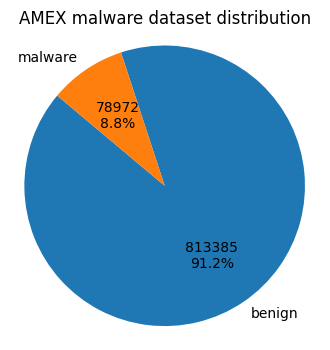

In [31]:
plot_label_distribution(labels=labels, class_names=['benign', 'malware'], plot_type='pie', figsize=(4, 4), title='AMEX malware dataset distribution')

In [38]:
len(columns_with_substring(data, substring='OPCODES')), len(columns_with_substring(data, substring='INTENTS')), len(columns_with_substring(data, substring='PERMISSIONS'))

(236, 410, 215)

## Create dataset

In [18]:
def create_datasets(data, metadata):

    X_train, X_test, y_train, y_test = train_test_split( 
        data, metadata, 
        test_size=0.30, 
        random_state=0, 
        shuffle=True
    )
    
    print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

    encoder_binary = OneHotEncoder().fit(np.expand_dims(metadata['LABELS'].values, axis=1))
    
    data_dict = {
        'X_train': X_train,
        'y_train_metadata': y_train,
        'y_train_ohe': encoder_binary.transform(np.expand_dims(y_train['LABELS'].values, axis=1)),
        'X_test': X_test,
        'y_test_metadata': y_test,
        'y_test_ohe': encoder_binary.transform(np.expand_dims(y_test['LABELS'].values, axis=1)),
        'classes_names': ['Benign', 'Malware']
        # 'classes': ['Normal', 'Supraventricular', 'Ventricular'],
    }
    
    return data_dict

In [19]:
data_dict = create_datasets(data, metadata)

(624649, 861) (267708, 861) (624649, 12) (267708, 12)


## Feature Selection

In [67]:
from sklearn.feature_selection import SelectKBest, chi2

In [68]:
chi2_stats, p_values = chi2(data.values, metadata['LABELS'].values)  # Virus total scanners detections >= 4

print(chi2_stats.shape, p_values.shape)

(861,) (861,)


In [92]:
df_chi2 = dataframe({
    'names': df_features['features'].values,          # from load_mh100()
    'stats': chi2_stats,
    'p_values': p_values
})

df_chi2.head()


chi2_sorted = df_chi2.sort_values(by='stats', ascending=False).dropna()

# chi2_features = df_chi2[df_chi2['p_values'] < 0.05]  ## significance level (e.g. α = .05), and .head for TOP K
chi2_features = chi2_sorted[chi2_sorted['p_values'] < 0.05]  ## significance level (e.g. α = .05), and .head for TOP K

In [93]:
chi2_sorted

,names,stats,p_values
596,INTENTS_USER_PRESENT,61086.290137,0.000000
771,INTENTS_EXTERNAL_APPLICATIONS_AVAILABLE,53868.843143,0.000000
657,INTENTS_PACKAGE_ADDED,48310.752642,0.000000
428,PERMISSIONS_GET_ACCOUNTS_PRIVILEGED,46844.051851,0.000000
521,INTENTS_RSSI_CHANGED,45753.212668,0.000000
...,...,...,...
288,PERMISSIONS_READ_ASSISTANT_APP_SEARCH_DATA,0.010915,0.916793
843,INTENTS_ACTION_CALL,0.007937,0.929012
610,INTENTS_CATEGORY_APP_GALLERY,0.003968,0.949771
721,INTENTS_PEERS_CHANGED,0.003963,0.949805


In [94]:
chi2_features

,names,stats,p_values
596,INTENTS_USER_PRESENT,61086.290137,0.000000
771,INTENTS_EXTERNAL_APPLICATIONS_AVAILABLE,53868.843143,0.000000
657,INTENTS_PACKAGE_ADDED,48310.752642,0.000000
428,PERMISSIONS_GET_ACCOUNTS_PRIVILEGED,46844.051851,0.000000
521,INTENTS_RSSI_CHANGED,45753.212668,0.000000
...,...,...,...
453,INTENTS_USER_INITIALIZE,3.964233,0.046477
743,INTENTS_ACTION_USER_BACKGROUND,3.911212,0.047965
486,INTENTS_SCO_AUDIO_STATE_CHANGED,3.890493,0.048560
133,OPCODES_const/16,3.865808,0.049279


In [103]:
chi2_features.to_csv(join(paths['data'], 'amex', 'amex-1M-chi2-features.csv'), index=False)

## Sampling

In [22]:
def balanced_random_sample(df, class_col, n_samples):
    """
    Selects a balanced random sample from the dataset based on the class label.

    Parameters:
    df (pd.DataFrame): DataFrame containing the data.
    class_col (str): The name of the column containing the class labels.
    n_samples (int): Number of samples to select from each class.

    Returns:
    pd.DataFrame: A DataFrame containing a balanced random sample of the data.
    """
    # Check if requested sample size per class is possible
    if any(df[class_col].value_counts() < n_samples):
        raise ValueError("Some classes do not have enough samples for the requested sample size.")

    # Group the DataFrame by the class column and sample n_samples from each group
    sampled_df = df.groupby(class_col).apply(lambda x: x.sample(n=n_samples)).reset_index(drop=True)

    return sampled_df

def balance_classes(df_data, y, metadata, MAX_INSTANCES):
    """
    Balances classes by under-sampling each class to a specified maximum number of instances.
    
    Parameters:
    - X: Features, numpy array of shape (n_samples, n_features)
    - y_ohe: One-hot encoded labels, numpy array of shape (n_samples, n_classes)
    - label_list: List of actual labels corresponding to each sample
    - MAX_INSTANCES: The maximum number of instances allowed per class.
    
    Returns:
    - A dictionary with balanced features, labels, one-hot encoded labels, actual label list, and indices.
    """
    # y = data_dict['labels']['labels']
    unique_classes = np.unique(y)
    sampled_indices = []
    
    np.random.seed(0)  # For reproducibility
    for class_id in unique_classes:
        # Find indices of the current class
        class_indices = np.where(y == class_id)[0]
        # Determine the number of instances to sample
        if len(class_indices) > MAX_INSTANCES:
            sampled_class_indices = np.random.choice(class_indices, MAX_INSTANCES, replace=False)
        else:
            sampled_class_indices = class_indices
        sampled_indices.append(sampled_class_indices)
    
    # Concatenate all sampled indices from each class
    under_sample_indices = np.concatenate(sampled_indices)
    
    # Create dictionary to return the balanced dataset
    dict = {
        'X': df_data.iloc[under_sample_indices],
        'labels': labels[under_sample_indices],
        'metadata': metadata.iloc[under_sample_indices],
        'idx': under_sample_indices,
    }

    return dict

In [27]:
balanced = balance_classes(
    df_data=data, 
    y=labels,
    metadata=metadata,
    MAX_INSTANCES=150)

In [29]:
dataframe(balanced['labels']).value_counts()

0    150
1    150
dtype: int64

In [30]:
name = 'amex-1M-balanced-150'

In [33]:
with open(os.path.join(paths['data'], 'sampling', f'{name}.pickle'), 'wb') as f:
    pickle.dump(balanced, f)
    

In [34]:
background = balance_classes(
    df_data=data, 
    y=labels,
    metadata=metadata,
    MAX_INSTANCES=20000)

In [36]:
dataframe(background['labels']).value_counts()

0    20000
1    20000
dtype: int64

In [37]:
background_name = 'amex-1M-background-20k'

In [40]:
with open(os.path.join(paths['data'], 'sampling', f'{background_name}.pickle'), 'wb') as f:
    pickle.dump(background, f)

# 3. Explore Malware Metadata

In [39]:
def process_malware_metadata(metadata):
    metadata['VT_SCANNERS_SUGGESTED_THREAT_LABEL'] = metadata['VT_SCANNERS_SUGGESTED_THREAT_LABEL'].str.replace('/','.')
    # metadata['VT_SCANNERS_SUGGESTED_THREAT_LABEL'] = metadata["VT_SCANNERS_SUGGESTED_THREAT_LABEL"].apply(lambda x: x.replace('/', '.'))
    metadata['FAMILY'] = metadata['VT_SCANNERS_SUGGESTED_THREAT_LABEL'].str.split('.').str[0]
    metadata['GROUP'] = metadata['VT_SCANNERS_SUGGESTED_THREAT_LABEL'].str.split('.').str[1]
    # df = metadata['VT_SCANNERS_SUGGESTED_THREAT_LABEL'].str.split('.').str[0]
    # df = metadata[~metadata['VT_SCANNERS_SUGGESTED_THREAT_LABEL'].isna()]
    return metadata

def notNaN(df, col):
    df[~df[col].isna()]
    return df[~df[col].isna()]

In [40]:
metadata = process_malware_metadata(metadata)
metadata

,VT_LAST_ANALYSIS_DATE,VT_SIZE,SHA256,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES,VT_SCANNERS,LABELS,FAMILY,GROUP
0,2021-10-18 05:26:42,11153644.0,F7E69BAD50EB274081A169111973308294333F92A212F4...,f6022cef562bfaa403ac304b11d1c165,1,1,0,60,NaN,[],0,0,NaN,NaN
1,2019-08-11 11:30:56,12920431.0,FF8FBF057F9E491C56336EA899F3963C84FD2F0C28A4D3...,ed4e1480af63f0205c1a73a31ebe2504,2,0,0,55,NaN,[],0,0,NaN,NaN
2,2022-01-30 08:11:17,159297.0,F99E66597467AD0744CBA190786FC2F4A1DE1F55B18D05...,21096e1cf41e6fe95e99d63fe3df921c,13,1,1,57,NaN,['Ikarus'],2,0,NaN,NaN
3,2020-06-03 12:50:42,8208151.0,FF460EB2830265BFD48E5CBC9EE2AEEFF6B46C15D62194...,2381358a0627d2f091c412eb2dd9159d,2,1,0,61,NaN,[],0,0,NaN,NaN
4,2019-02-22 22:53:46,2238737.0,F6C5A30B00444056E2835D81411C05A84579386C150630...,7b1dec0cf91e0579783051ee6488b24a,1,0,0,60,NaN,[],0,0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
892352,2023-01-17 05:10:28,73859390.0,F97ED8E5BC8A774B357071880204EB1219E39554DDB0A0...,6cd2bb997d4c255991da4e1a267c1746,1,1,0,64,NaN,[],0,0,NaN,NaN
892353,2023-07-30 01:11:03,46851224.0,F8521F6BB752B0F3FE4793CDC80202EBD2D86BB31FA9D8...,ef10042af05e84fbfef83dae8fd484fc,5,0,1,63,NaN,['MaxSecure'],1,0,NaN,NaN
892354,2023-04-04 02:21:46,44487240.0,FB2404CB8E03ADB706D51D73E8C9E5CB66261E6E0C7A06...,bcfe5f90543169fdea25810acd0ce906,2,0,0,64,NaN,[],0,0,NaN,NaN
892355,2020-07-14 13:34:30,4137446.0,FDD12ADC4B5C9E60D073526BDA9D3AA9B03F0E2B0DB9A2...,a5440a0a446cd2948537c8791f1da619,1,2,0,62,NaN,[],0,0,NaN,NaN


## Defining Families

In [41]:
# 0 Benign
# 1 Adware
# 2 Trojan
# 3 Riskware
malware_dict = {'Benign': 0, 'Adware': 1, 'Trojan': 2, 'Riskware': 3}
classes_names = ['Benign', 'Adware', 'Trojan', 'Riskware']
malware_classes = ['Adware', 'Trojan', 'Riskware']

malware_to_number = {
    'adware': 1,
    'trojan': 2,
    'pua': 3,
    'jiagu': 1,
    'anydown': 3,
    'tencentprotect': 3,
	'hifrm': 3,
	'inmobi': 3,
	'virus': 2,
	'appsgeyser': 1,
	'kuguo': 2,
	'smsreg': 2,
	'dowgin': 3,
	'locker': 2,
	'scamapp': 2,
	'umpay': 3,
	'autoins': 3,
	'dropper': 2,
	'cauly': 2,
	'fibr': 2,
	'hamob': 1,
	'spinok': 2,
	'secapk': 3,
	'secneo': 3,
}

def map_name_to_number(name):
    return malware_to_number.get(name, 4)  # Default to 7 if name is not found


def categorize_malware(malware_type):
    mapping = {
        'adware': 0,
        'trojan': 1,
        'pua': 2
    }
    # Return the mapped value if exists, otherwise return 3
    return mapping.get(malware_type, 3)

In [44]:
np.unique(df_malware['ID_FAMILY'])

array([1, 2, 3, 4], dtype=int64)

In [42]:
df_malware = notNaN(df=metadata, col='VT_SCANNERS_SUGGESTED_THREAT_LABEL')
df_malware = df_malware[df_malware['LABELS']==1]
df_malware['ID_FAMILY'] = df_malware['FAMILY'].apply(map_name_to_number)
df_malware

,VT_LAST_ANALYSIS_DATE,VT_SIZE,SHA256,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES,VT_SCANNERS,LABELS,FAMILY,GROUP,ID_FAMILY
8,2014-05-27 15:06:28,19831672.0,FA6E0C6C9211A21B4CF2CBE1A8D59DDCCA20615DB78976...,2fc3b414cf6b0242df651a3387f1a31d,1,0,12,40,adware.dowgin,"['MicroWorld-eScan', 'F-Prot', 'BitDefender', ...",24,1,adware,dowgin,1
23,2020-01-24 08:47:58,2914673.0,FA0BBA354DA093EE6A3008F7E86D940BEA35A32E0B0D2F...,4929359910c763bfdd4e92ce4c46b4d7,4,0,7,57,trojan.jiagu,"['Zillya', 'Trustlook', 'K7GW', 'Cyren', 'Fort...",8,1,trojan,jiagu,2
26,2020-05-30 03:22:55,1182090.0,FC253C5113E7B89FCEDE6DD2B01F72DF364AA762A24BDC...,7b555dd5ae73f41ada69a8a398ecf0b7,1,1,17,46,trojan.fakeapp.dnotua,"['AegisLab', 'CAT-QuickHeal', 'McAfee', 'Aliba...",23,1,trojan,fakeapp,2
38,2022-12-27 12:37:58,16627726.0,FC4D02E56B45C731ED5307CBBFBFED9A19930BD7296FC3...,a1e3389f754ef4f918b529efe276f6b2,3,0,19,46,trojan.jiagu,"['Lionic', 'MicroWorld-eScan', 'FireEye', 'Zil...",18,1,trojan,jiagu,2
44,2021-08-01 05:27:09,5346502.0,F69093548FB440C52E7D128D6F9A5BA3D0159FD009860E...,736ccbfd3cf5ea618fac75effe51bdf0,2,0,6,57,adware.inmobi,"['Lionic', 'ESET-NOD32', 'Ikarus', 'Avira', 'C...",8,1,adware,inmobi,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
892266,2023-04-17 14:05:05,34518660.0,FD392CFAD6C805AAD0E80A74CCA87930E5387BFD8C9FD8...,3e02fabdb426be379cbd99d45f52b2a8,5,0,14,50,trojan.jiagu.uselvgb22,"['Trustlook', 'K7GW', 'Cyren', 'ESET-NOD32', '...",14,1,trojan,jiagu,2
892314,2023-05-29 18:06:09,11179634.0,FAF68517B4778F82F3090FC44CD4FFC5A01CAC517EF882...,734e68dd516bce55aec1c80c1b4d4662,2,0,17,48,trojan.ginmaster,"['Lionic', 'CAT-QuickHeal', 'Trustlook', 'K7GW...",17,1,trojan,ginmaster,2
892326,2023-05-14 03:52:23,37893972.0,F8578E902BA1904E08D14897B1CBC215755CAF79208005...,7bc9b06cbda8161894d74ee1247e9608,1,11,8,47,trojan.,"['Zillya', 'K7GW', 'Cyren', 'SymantecMobileIns...",8,1,trojan,,2
892336,2023-04-26 14:04:56,346482.0,FD1936B37AC4D2501B836D0B09F8F52DEA7F7182D70A52...,f51f48ae7fe50e11f1f846aeac729ae5,3,0,26,38,trojan.boogr.fkoh,"['Lionic', 'CAT-QuickHeal', 'Trustlook', 'K7GW...",26,1,trojan,boogr,2


In [55]:
df_malware['ID_FAMILY'].value_counts().index.values

array([1, 2, 3, 4], dtype=int64)

(array([1, 2, 3, 4], dtype=int64),
 array([37654, 24190,  6448,  2055], dtype=int64))

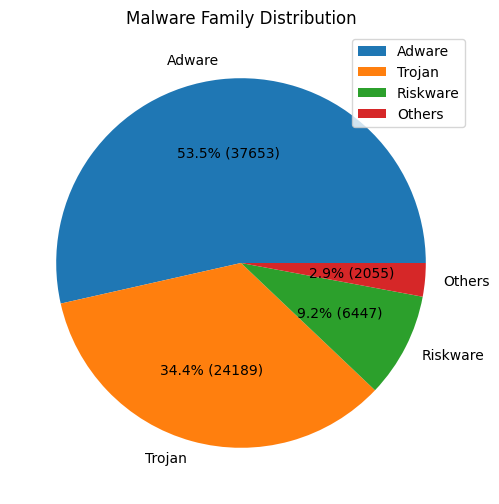

In [70]:
plot_distribution(df_labels=df_malware['ID_FAMILY'], labels_names=['Adware', 'Trojan', 'Riskware', 'Others'], title='Malware Family Distribution', figsize=(6, 6))

In [72]:
df_malware['GROUP'].value_counts()

dowgin     8650
jiagu      6705
kuguo      3788
           3703
airpush    3414
           ... 
fgmb          1
rezng         1
dianjoy       1
flox          1
talkw         1
Name: GROUP, Length: 1171, dtype: int64

In [73]:
df_malware['ID_FAMILY'].value_counts()

1    37654
2    24190
3     6448
4     2055
Name: ID_FAMILY, dtype: int64

In [74]:
# df_malware.to_csv(join(paths['data'], 'amex', 'amex-1M-malware-metadata.csv'))

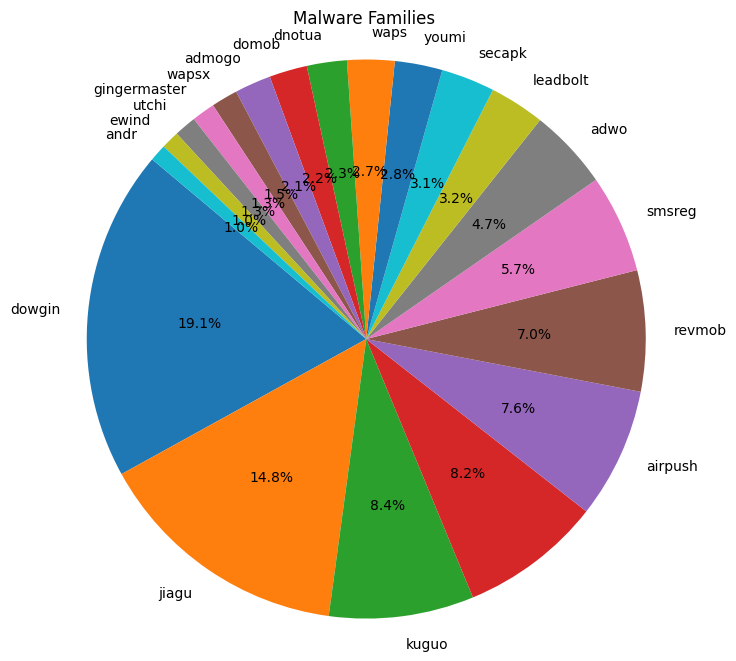

In [68]:
# Plot the pie chart

value_counts= df_malware['GROUP'].value_counts()

plt.figure(figsize=(8, 8))  # Optional: Adjust the size of the figure
plt.pie(value_counts[0:20], labels=value_counts[0:20].index, autopct='%1.1f%%', startangle=140)
plt.axis('equal')  # Equal aspect ratio ensures the pie chart is circular.
plt.title('Malware Families')  # Optional: Set the title of the pie chart
plt.show()

In [72]:
# save malware data

malware_data = data.iloc[df_malware.index]
malware_data

,OPCODES_rem-long/2addr,OPCODES_const,OPCODES_aput,OPCODES_mul-float/2addr,OPCODES_add-int/lit16,OPCODES_if-eqz,OPCODES_add-float,OPCODES_sput-short,OPCODES_iput-byte/jumbo,OPCODES_aget,...,INTENTS_ANR,INTENTS_SIP_INCOMING_CALL,INTENTS_OTA_STATUS_CHANGED,INTENTS_APPWIDGET_HOST_RESTORED,INTENTS_CATEGORY_ALTERNATIVE,INTENTS_REPORT,INTENTS_AUDIO_BECOMING_NOISY,INTENTS_ACTION_INSERT,INTENTS_HDMI_PLUGGED,INTENTS_DISCOVERY_STATE_CHANGE
8,1,1,1,1,1,1,1,0,0,1,...,0,0,0,0,0,0,0,0,0,0
23,0,0,1,0,0,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0
26,0,1,1,1,0,1,1,0,0,1,...,0,0,0,0,0,0,0,0,0,0
38,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
44,1,0,1,1,0,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
892266,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
892314,1,0,1,1,0,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
892326,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
892336,1,1,1,1,1,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0


In [74]:
malware_data.to_csv(join(paths['data'], 'amex', 'amex-1M-malware.csv'), index=False)

# Visualization

In [88]:
def plotly_scatter(X_embedded, labels, info, path_save=None):
    """
    Plots a 2D scatter plot of the t-SNE results with Plotly.

    Parameters:
    X_embedded (array): A 2D array of shape (n_samples, 2) resulting from t-SNE or similar.
    labels (array): An array of labels corresponding to each point in X_embedded.
    """
    # Create a DataFrame for the embedded coordinates and labels
    df = pd.DataFrame(X_embedded, columns=['x', 'y'])
    df['labels'] = labels
    df['ix'] = df['labels'].index.values
    df['id_subject'] = info['id_subject']
    df['label_list'] = info['label_list']
    df['true_labels'] = info['true_labels']
    # Create the scatter plot
    fig = px.scatter(df, x='x', y='y', color='labels',
                     color_discrete_sequence=px.colors.qualitative.G10, # Using a predefined set of discrete colors
                     title="2D Visualization of Data",
                     labels={'labels': 'Labels'},
                     width=800, height=600,
                     hover_data=['id_subject', 'label_list', 'true_labels'])

    # Update markers size and other aesthetic settings
    fig.update_traces(marker=dict(size=3))
    
    # Customize legend
    fig.update_layout(legend_title_text='Group', 
                      legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.01))

    if path_save: fig.write_html(path_save)
        
    # Show the figure
    fig.show()

def sns_plot(X_embedded, labels, path_save=None):

    df = pd.DataFrame(X_embedded, columns=['Component 1', 'Component 2'])
    df['Label'] = labels  # Assuming this is how your labels are stored

    # Plotting using Seaborn
    plt.figure(figsize=(6, 4))  # Optional: Adjust the figure size as needed
    ax = sns.scatterplot(data=df, x='Component 1', y='Component 2', hue='Label', style='Label', s=10, palette='bright', edgecolor='none')
    
    # Adjust legend and plot parameters as needed
    ax.legend(
        labels=np.unique(labels),
        title='Malware Type', 
              title_fontsize='9', 
              fontsize='8', 
        # bbox_to_anchor=(1, 1), 
        loc='upper right'
             )
    # plt.title('2D Projection of Heartbeats')
    plt.xlabel('Component 1')  # Adjust axis labels if needed
    plt.ylabel('Component 2')
    # plt.grid(True)  # Optional: Add grid for better visibility

    if path_save: plt.savefig(path_save+'.pdf', format='pdf', dpi=64, bbox_inches='tight')
    plt.show()

    return

In [76]:
chi2_features = pd.read_csv(join(paths['data'], 'amex', 'amex-1M-chi2-features.csv'))
chi2_features

,names,stats,p_values
0,INTENTS_USER_PRESENT,61086.290137,0.000000
1,INTENTS_EXTERNAL_APPLICATIONS_AVAILABLE,53868.843143,0.000000
2,INTENTS_PACKAGE_ADDED,48310.752642,0.000000
3,PERMISSIONS_GET_ACCOUNTS_PRIVILEGED,46844.051851,0.000000
4,INTENTS_RSSI_CHANGED,45753.212668,0.000000
...,...,...,...
673,INTENTS_USER_INITIALIZE,3.964233,0.046477
674,INTENTS_ACTION_USER_BACKGROUND,3.911212,0.047965
675,INTENTS_SCO_AUDIO_STATE_CHANGED,3.890493,0.048560
676,OPCODES_const/16,3.865808,0.049279


In [81]:
df_malware.head(3)

,VT_LAST_ANALYSIS_DATE,VT_SIZE,SHA256,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES,VT_SCANNERS,LABELS,FAMILY,GROUP,ID_FAMILY
8,2014-05-27 15:06:28,19831672.0,FA6E0C6C9211A21B4CF2CBE1A8D59DDCCA20615DB78976...,2fc3b414cf6b0242df651a3387f1a31d,1,0,12,40,adware.dowgin,"['MicroWorld-eScan', 'F-Prot', 'BitDefender', ...",24,1,adware,dowgin,1
23,2020-01-24 08:47:58,2914673.0,FA0BBA354DA093EE6A3008F7E86D940BEA35A32E0B0D2F...,4929359910c763bfdd4e92ce4c46b4d7,4,0,7,57,trojan.jiagu,"['Zillya', 'Trustlook', 'K7GW', 'Cyren', 'Fort...",8,1,trojan,jiagu,2
26,2020-05-30 03:22:55,1182090.0,FC253C5113E7B89FCEDE6DD2B01F72DF364AA762A24BDC...,7b555dd5ae73f41ada69a8a398ecf0b7,1,1,17,46,trojan.fakeapp.dnotua,"['AegisLab', 'CAT-QuickHeal', 'McAfee', 'Aliba...",23,1,trojan,fakeapp,2


## UMAP

In [79]:
import umap  # pip install umap-learn
import plotly.express as px
import pandas as pd

In [82]:
manifold = umap.UMAP().fit(malware_data[chi2_features['names'].values[0:200]].values, df_malware['ID_FAMILY'].values)

In [83]:
X_reduced = manifold.transform(
    malware_data[chi2_features['names'].values[0:200]].values
    )

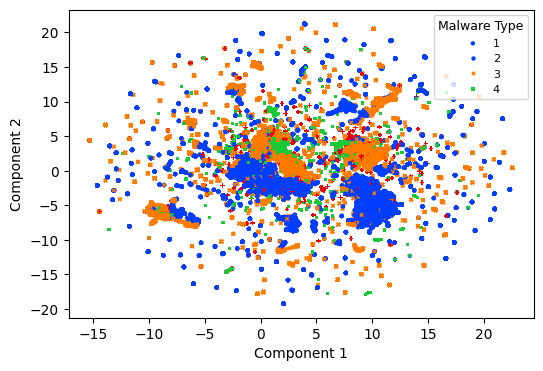

In [90]:
sns_plot(X_reduced, df_malware['ID_FAMILY'].values, join(base_dir, 'imgs', 'embed', 'UMAP'))

In [ ]:
with open(join(base_dir, 'results', 'embed', 'UMAP-SAX.pickle'), 'wb') as f:
    pickle.dump({'umap': manifold, 'transform': X_reduced}, f)

In [97]:
def plotly_scatter(X_embedded, labels, metadata, path_save=None):
    """
    Plots a 2D scatter plot of the t-SNE results with Plotly.

    Parameters:
    X_embedded (array): A 2D array of shape (n_samples, 2) resulting from t-SNE or similar.
    labels (array): An array of labels corresponding to each point in X_embedded.
    """
    # Create a DataFrame for the embedded coordinates and labels
    df = pd.DataFrame(X_embedded, columns=['x', 'y'])
    df['labels'] = labels
    # df['id_'] = metadata['LABELS'].index.values
    df['family'] = metadata['FAMILY'].values
    df['group'] = metadata['GROUP'].values
    df['vt_malicious'] = metadata['VT_SCANNERS_MALICIOUS'].values
    # Create the scatter plot
    fig = px.scatter(df, x='x', y='y', color='labels',
                     color_discrete_sequence=px.colors.qualitative.G10, # Using a predefined set of discrete colors
                     title="2D Visualization of Data",
                     labels={'labels': 'Labels'},
                     width=800, height=600,
                     hover_data=['labels', 'family', 'group', 'vt_malicious'])

    # Update markers size and other aesthetic settings
    fig.update_traces(marker=dict(size=3))
    
    # Customize legend
    fig.update_layout(legend_title_text='Group', 
                      legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.01))

    if path_save: fig.write_html(path_save)
        
    # Show the figure
    fig.show()

In [98]:
plotly_scatter(
    X_embedded=X_reduced, 
    labels=df_malware['ID_FAMILY'].values,
    metadata=df_malware,
    path_save=join(base_dir, 'imgs', 'embed', 'UMAP.html'))

# AMEX OPCODE ONLY dataset

In [5]:
def load_data(path_data, path_metadata, sep=',', class_threshold=4):

    metadata = pd.read_csv(path_metadata,  sep=sep) # nrows=1, # usecols=['VT_SCANNERS'])  
    metadata = csv.drop_duplicates(subset=['SHA256'], keep='last').reset_index(drop=True)
    print('loading metadata with shape: ', metadata.shape)
    
    df_csv = pd.read_csv(path_data, sep=sep)
    # filter metadata with valid sha256
    df_csv = df_csv[df_csv['SHA256'].isin(metadata['SHA256'])].reset_index(drop=True)
    print('loading data with shape: ', df_csv.shape)
    
    sha256 = df_csv['SHA256']
    vt_scanners = df_csv['VT_SCANNERS']
    df_csv.drop(columns=['SHA256', 'VT_SCANNERS'], inplace=True)
    data = np.asarray(df_csv.values, dtype=np.int8)
    labels = create_class(vt_scanners, class_threshold)
    ## generating one hot encoders
    labels_ohe = OneHotEncoder(dtype=int).fit_transform(np.expand_dims(labels, axis=1)).toarray()
    class_names=['benign', 'malware']
    column_names = df_csv.columns.values

    # df_sha256[df_sha256['SHA256'].isin(metadata['SHA256'])].reset_index(drop=True)

    
    return {'data': data, 
            'labels': labels, 
            'labels_ohe': labels_ohe, 
            'class_names': class_names, 
            'column_names': column_names, 
            'sha256': sha256,
            'metadata': metadata
           }

def create_class(df, threshold):
    return np.asarray([1 if i>=threshold else 0 for i in df ])

In [6]:
files = dataframe(os.listdir(paths['amexplorer']), columns=['filename'])
files

,filename
0,8K_APKs_binary.csv
1,8K_APKs_discrete.csv
2,8K_APKs_metadata.csv
3,binary_100K_per_int_opc.csv
4,binary_1M.csv
5,metadata.csv
6,VT_metadata-binary_1M.csv


In [41]:
# csv = pd.read_csv( join(paths['amexplorer'], files['filename'].iloc[3]), sep=',', nrows=2)  

## Load

In [13]:
# LOAD DATA

data_dict = load_data(
    path_data=join(paths['amexplorer'], files['filename'].iloc[3]), 
    path_metadata=join(paths['amexplorer'], files['filename'].iloc[4]), 
    sep=',', 
    class_threshold=4
)

print(data_dict['data'].shape, data_dict['labels'].shape)
print()
print(pd.DataFrame(data_dict['labels']).value_counts())

loading metadata with shape:  (100938, 17)
loading data with shape:  (100938, 710)
(100938, 708) (100938,)

0    92384
1     8554
dtype: int64


In [14]:
data_dict.keys()

dict_keys(['data', 'labels', 'labels_ohe', 'class_names', 'column_names', 'sha256', 'metadata'])

In [15]:
data_dict['metadata']

,VT_LAST_ANALYSIS_DATE,VT_SIZE,SHA256,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES,AZ_DETECTION,AZ_SCAN_DATE,AZ_MARKETS,AG_APP_NAME,AG_PACKAGE,AG_TARGET_API,AG_MIN_API
0,2022-06-12 08:19:40,9937580,E29BCFBB418CACF48E80FA88A0C6FA01C941EE39289087...,65e49bacc7257c7957bcc6023de6a7c4,2,0,0,61,NaN,[],0.0,2022-06-12 08:19:40,play.google.com,Issuu,com.issuu.android.app,30,18
1,2023-07-18 03:53:52,6955916,E202EBDE43219A5F2456A5F456DB17BA038D106A7647B0...,9455e01c2d869fc011dd86064e662c50,2,10,0,53,NaN,[],0.0,2020-07-06 12:19:08,play.google.com,Live Kirtan,parwinder.singh.livekirtan,29,16
2,2019-11-14 19:08:30,6165576,E2B66D71B410303DD021899367B8413137ED166A4C4B40...,c09bd985bb11bd09502c604f7b1ad808,1,0,0,58,NaN,[],0.0,2019-03-06 10:43:35,play.google.com,bestarabia,com.revesoft.mobiledialer.bestarabia_149000361...,26,16
3,2023-06-18 04:00:29,2023282,E21F9A69674B5F4212ED8878DE232922CE536CB7A35CDA...,3c496c579e83116ed4c2a9d0a7e67b84,1,0,0,64,NaN,[],0.0,2022-06-09 06:09:21,play.google.com,Dinstructor for Users,appstudentsdinstructorcom.wpapp,31,19
4,2023-02-22 08:52:49,14152758,E1D04112CBEDDE9463EC7B3D572FCC6E8E34894C3FDDAE...,89452292367cbf2cfa7e9ed670e58570,1,0,0,63,NaN,[],0.0,2023-02-22 08:52:49,play.google.com,Fakaza Music,com.wrimadt.fwkerodd,31,23
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100933,2023-04-18 07:53:45,17081932,E1A2A612CB0F23541153922D2451DDEECBC7377E782547...,f0085bf7db26428749dcfb45ba1f1598,1,0,0,63,NaN,[],0.0,2023-04-18 07:53:45,play.google.com,WashXL,com.washxl,31,23
100934,2023-03-13 07:49:15,41552957,E1FAD8B92C7847FA2A23AF528A4ED63682BA5999B4F9F4...,9e66249ae864d9af5b3e120208310270,1,2,0,53,NaN,[],0.0,2023-03-13 07:49:15,play.google.com,Fish Evolution,com.tara.fishevolution,31,19
100935,2019-08-12 16:40:47,4298233,E23F0C9FA4E9F0EBDD8D148407744FABDF1DF6240E7E60...,880a4d9a62b923d8ee00c63b8634cd58,1,0,0,59,NaN,[],0.0,2018-06-30 19:31:24,play.google.com,Video Player New,com.video.player.new.videoplayernew,25,15
100936,2023-06-07 19:43:26,5694813,E29BFB3063A5D8D4E776200A9611FAB0DDC34EB3C73158...,8153a29ea292c7eedef56b82287077b9,8,0,0,64,NaN,[],0.0,2018-03-16 17:09:02,play.google.com,Acu points for 300 diseases,atozcure.a21acu,26,15


In [53]:
import pickle
with open(join(paths['data'], 'amex-100k-dict.pickle'), 'wb') as f:
    pickle.dump(data_dict, f)

In [59]:
metadata['SHA256'].values

array(['E29BCFBB418CACF48E80FA88A0C6FA01C941EE39289087B3538C8C1F74C63AD9',
       'E202EBDE43219A5F2456A5F456DB17BA038D106A7647B039AFFAE31E569C2E47',
       'E2B66D71B410303DD021899367B8413137ED166A4C4B40F5B513B9D440E4E2FD',
       ...,
       'E23F0C9FA4E9F0EBDD8D148407744FABDF1DF6240E7E60B5DB596E5CEDFB4846',
       'E29BFB3063A5D8D4E776200A9611FAB0DDC34EB3C73158066F995C79D9AEB903',
       'E22F013D7CCCCBFF349F2148F29D70335463AEE944DA8A107D4C790FF100462D'],
      dtype=object)

## Read

In [16]:
import pickle
with open(join(paths['data'], 'amex-100k-dict.pickle'), 'rb') as f:
    data_dict = pickle.load(f)

In [19]:
data_dict.keys()

dict_keys(['data', 'labels', 'labels_ohe', 'class_names', 'column_names', 'sha256', 'metadata'])

## Process Malware Metadata

In [21]:
def process_amex(path_data, path_metadata, sep=',', class_threshold=4):

    csv_metadata = pd.read_csv(path_metadata,  sep=sep) # nrows=1, # usecols=['VT_SCANNERS'])  
    csv_metadata = csv.drop_duplicates(subset=['SHA256'], keep='last').reset_index(drop=True)
    print('loading metadata with shape: ', csv_metadata.shape)
    
    df_csv = pd.read_csv(path_data, sep=sep)
    # filter metadata with valid sha256
    df_csv = df_csv[df_csv['SHA256'].isin(metadata['SHA256'])].reset_index(drop=True)
    print('loading data with shape: ', df_csv.shape)
    
    ## Merge dataframes based on SHA256
    df_merge = df_csv.merge(metadata, on='SHA256', how='outer')
    

    
    df_csv.drop(columns=['SHA256', 'VT_SCANNERS'], inplace=True)
    feature_names = df_csv.columns.values
    metadata_names = metadata.columns.values


    df_data = df_merge[df_merge.columns.intersection(feature_names)].astype(np.int8)
    df_metadata = df_merge[df_merge.columns.intersection(metadata_names)]

    sha256 = df_merge['SHA256']
    vt_scanners = df_merge['VT_SCANNERS']
    df_metadata['VT_SCANNERS'] = vt_scanners
    
    labels = create_class(vt_scanners, class_threshold)
    df_metadata['LABELS'] = np.asarray(labels)
    
    
    ## generating one hot encoders
    labels_ohe = OneHotEncoder(dtype=int).fit_transform(np.expand_dims(labels, axis=1)).toarray()
    class_names=['benign', 'malware']
    
    # # column_names = df_csv.drop(columns=['SHA256', 'VT_SCANNERS'], inplace=False).columns.values
    # print(column_names)
    
    return df_data, df_metadata, class_names, sha256

In [22]:
files = dataframe(os.listdir(paths['amexplorer']), columns=['filename'])
files

,filename
0,8K_APKs_binary.csv
1,8K_APKs_discrete.csv
2,8K_APKs_metadata.csv
3,binary_100K_per_int_opc.csv
4,metadata.csv


In [23]:
df_data, df_metadata, class_names, sha256 = process_amex(
    path_data=join(paths['amexplorer'], files['filename'].iloc[3]), 
    path_metadata=join(paths['amexplorer'], files['filename'].iloc[4]), 
    sep=',', 
    class_threshold=4
)

loading metadata with shape:  (100938, 17)
loading data with shape:  (100938, 710)


C:\Users\hendr\AppData\Local\Temp\ipykernel_21152\3468005993.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_metadata['VT_SCANNERS'] = vt_scanners
C:\Users\hendr\AppData\Local\Temp\ipykernel_21152\3468005993.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_metadata['LABELS'] = np.asarray(labels)


In [24]:
df_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 100938 entries, 0 to 100937
Columns: 708 entries, OPCODES_const-class to PERMISSIONS_BIND_QUICK_SETTINGS_TILE
dtypes: int8(708)
memory usage: 68.9 MB


In [25]:
df_data

,OPCODES_const-class,OPCODES_sput-byte,OPCODES_monitor-enter,OPCODES_move-object,OPCODES_rem-int/2addr,OPCODES_int-to-char,OPCODES_or-long,OPCODES_add-double/2addr,OPCODES_invoke-direct/range,OPCODES_if-le,...,PERMISSIONS_BROADCAST_SMS,PERMISSIONS_READ_MEDIA_IMAGES,PERMISSIONS_REQUEST_COMPANION_RUN_IN_BACKGROUND,PERMISSIONS_WRITE_SECURE_SETTINGS,PERMISSIONS_MOUNT_FORMAT_FILESYSTEMS,PERMISSIONS_INTERACT_ACROSS_PROFILES,PERMISSIONS_WRITE_EXTERNAL_STORAGE,PERMISSIONS_FOREGROUND_SERVICE_CONNECTED_DEVICE,PERMISSIONS_DELETE_PACKAGES,PERMISSIONS_BIND_QUICK_SETTINGS_TILE
0,1,0,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
1,1,0,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
2,1,0,1,1,1,0,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
3,1,0,1,1,0,0,0,1,1,1,...,0,0,0,0,0,0,1,0,0,0
4,1,0,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100933,1,0,1,1,0,0,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
100934,1,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,1,0,0,0
100935,1,0,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,1,0,0,0
100936,1,0,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,1,0,0,0


In [26]:
df_metadata

,SHA256,VT_LAST_ANALYSIS_DATE,VT_SIZE,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES,AZ_DETECTION,AZ_SCAN_DATE,AZ_MARKETS,AG_APP_NAME,AG_PACKAGE,AG_TARGET_API,AG_MIN_API,VT_SCANNERS,LABELS
0,E1A91568AEC62F8857092DDF119ED23380EE27FB94931B...,2023-06-27 00:30:55,10013084,6aee4723f0833a140491114e3432b521,2,5,2,57,NaN,"['TrendMicro-HouseCall', 'Fortinet']",3.0,2020-07-13 14:11:47,play.google.com,SoalUKG,com.cakrawalailmu12.ujikompetensigurusoalukgte...,28,15,2,0
1,E205ABB645BE1BDFB804BA3041AF37979825B615059825...,2016-08-03 16:35:59,4266069,f43bd13c20ea676bf10ad4f82080b1b4,1,0,0,54,NaN,[],0.0,2016-07-09 18:13:03,play.google.com,"Gargantua and Pantagruel, Illustrated, Book 4",jp.komakuro.book8169,23,9,0,0
2,E1AA450F30C18B21DC558B8806FF9EAE8B5BF8A89943E2...,2023-07-19 01:59:39,4629170,403d2b0de76b079b155609fea54e3b31,2,0,3,61,NaN,"['SymantecMobileInsight', 'BitDefenderFalx', '...",8.0,2016-01-26 07:49:46,PlayDrone|play.google.com,suppressed,com.lwi.projects.P2011_10_trinec,4,1,3,0
3,E23EFA579B47A86D72CAC20AC62ED0C5D49089F11E9574...,2023-06-17 03:53:26,3233691,24446ded0b8e9277f2cbdbda75170d64,2,1,30,34,adware.waps/apofer,"['Lionic', 'DrWeb', 'CAT-QuickHeal', 'Trustloo...",11.0,2014-07-12 00:32:52,appchina,suppressed,com.mobi.livewallpaper.dmyh,7,7,30,1
4,E232C6993DEBD247C04AD8E00663A56608953C1DA34BC0...,2020-09-18 23:19:43,20793217,b51772f40b21018c2de2f449f21df9fd,3,1,0,61,NaN,[],0.0,2020-03-11 05:45:37,play.google.com,CarIndustryTycoon,com.AdrianZarzycki.idle.incremental.car.indust...,28,23,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100933,E24AA7490EFE41003057C9560078119D55C94B74A01349...,2023-06-22 03:38:55,11755811,e5172060bbbf72b15f46be29a64d052e,4,6,0,54,NaN,[],0.0,2016-02-02 23:31:12,PlayDrone|play.google.com,Ruleta Turista Mundial Apps,com.widowgames.ruletaTuristaMundialApps,19,9,0,0
100934,E1B791E054B9190CAB6F21094831E44D29298B65AA8AEC...,2023-06-10 02:00:32,6885686,e914f14b92f8c41b2048266b4033f9fc,1,1,0,64,NaN,[],0.0,2019-10-06 01:56:56,play.google.com,Bizwiz Sales,com.webparadox.bizwizsales,26,16,0,0
100935,E28CB87DF9C4AF183F8CECF40713F6199810097529A40A...,2023-07-16 05:40:40,45816617,54f251d30ab2035d1acc81e6f31c83b8,2,0,0,65,NaN,[],0.0,2022-01-04 14:09:13,play.google.com,BOCHK iGTB,com.bochk.igtb,28,24,0,0
100936,E1ECC7D5725BACF197F0F1768898D59F41A6194968C89A...,2023-07-18 03:40:41,24505516,17207a6333004cdb0cfb87f66bb69257,1,14,0,42,NaN,[],0.0,2020-06-26 09:41:46,play.google.com,MELZ,com.melzindcosys.app,26,19,0,0


In [27]:
df_malware = df_metadata [df_metadata['LABELS']>0]
df_benign = df_metadata [df_metadata['LABELS']==0]

df_malware

,SHA256,VT_LAST_ANALYSIS_DATE,VT_SIZE,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES,AZ_DETECTION,AZ_SCAN_DATE,AZ_MARKETS,AG_APP_NAME,AG_PACKAGE,AG_TARGET_API,AG_MIN_API,VT_SCANNERS,LABELS
3,E23EFA579B47A86D72CAC20AC62ED0C5D49089F11E9574...,2023-06-17 03:53:26,3233691,24446ded0b8e9277f2cbdbda75170d64,2,1,30,34,adware.waps/apofer,"['Lionic', 'DrWeb', 'CAT-QuickHeal', 'Trustloo...",11.0,2014-07-12 00:32:52,appchina,suppressed,com.mobi.livewallpaper.dmyh,7,7,30,1
12,E2B030651EE6939AFB1218614D742D9EDB3968CCCF0DF5...,2021-07-31 18:48:09,4833212,cdf7e9f2bb0e93995df92078b3856c7a,1,0,10,53,appsgeyser,"['CAT-QuickHeal', 'Trustlook', 'K7GW', 'Symant...",1.0,2016-03-22 04:13:48,play.google.com,suppressed,com.wQuranmczlri,20,9,13,1
14,E1DB8419131FCDE6233EC5CFBBC2897551E4CB395F930F...,2021-07-31 18:18:09,15304073,b032b79e588e3b7d3cee179aa7d412ac,1,0,3,60,anydown,"['SymantecMobileInsight', 'ESET-NOD32', 'Ikarus']",3.0,2016-02-22 11:11:00,play.google.com,Military Photo Montage,com.MilitaryPhotoMontageBest,21,10,5,1
17,E28B7BC0C47CC2F485C178E0EED53A03A19C8F05B41B4E...,2023-07-21 06:28:56,8623275,a2928bcf0ac648bfb91ae98ca0b87918,2,0,12,52,adware.revmob/andr,"['K7GW', 'Trustlook', 'VirIT', 'SymantecMobile...",17.0,2016-02-22 11:21:39,play.google.com,Clash of Zombie,com.mobilegameappsriku.clashofzombie.simulator,17,10,12,1
19,E27FC52DCCA9C0E952FA36010032544017C0A07529F566...,2023-06-16 06:33:06,5691848,4c5d7754c1a67477f597e42aca9ebece,1,6,22,37,adware.domob/mobwin,"['CAT-QuickHeal', 'McAfee', 'Trustlook', 'VirI...",3.0,2013-09-26 11:59:24,appchina,suppressed,com.ts.dzwz,4,4,22,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100847,E23D7D384F7E3E38C7C3549BB28404ABEF5C8B72E9B2BE...,2023-06-15 04:04:10,4830780,db6d73ce60608b5701976f1223bbd2d3,3,0,27,37,pua.fakeapp/robtes,"['Lionic', 'CAT-QuickHeal', 'McAfee', 'Sangfor...",17.0,2020-07-02 14:41:25,VirusShare,suppressed,com.gufhn.plknhh,27,21,27,1
100890,E213A6D54FF08FCC0E88D25BC52AB481F2CB6E304BC52F...,2023-07-07 01:47:38,9863701,bf83ebaf332179cd2bc41683127ac5f0,1,1,4,57,clientor,"['CAT-QuickHeal', 'Ikarus', 'Google', 'BitDefe...",2.0,2018-06-29 12:12:04,play.google.com,Military Skins,military.skins.mcpe,21,16,4,1
100909,E2859E7FF9B6FEB74769F9AF48D2E579672B176B40F2A0...,2023-07-12 04:48:26,2151914,2883959ffd91afd4ea378d3eab92d046,1,0,23,42,adware.adwo/mobwin,"['Lionic', 'CAT-QuickHeal', 'McAfee', 'VirIT',...",15.0,2013-10-19 22:24:15,appchina,suppressed,org.vv.children.music,8,8,23,1
100920,E1F7B9A62FA8EA58962023865A46214F1E63A7CF8C65FA...,2022-03-11 09:22:40,2253618,15affccc6c8ef6e8b0d64372eec374c4,9,0,33,29,trojan.skymobi/smsreg,"['Lionic', 'DrWeb', 'CAT-QuickHeal', 'McAfee',...",36.0,2019-05-10 17:02:54,VirusShare,suppressed,com.sm.a32video,8,8,31,1


In [28]:
df_data.to_csv(join(paths['data'], 'amex-100k.csv'))
df_metadata.to_csv(join(paths['data'], 'amex-100k-metadata.csv'))

In [29]:
df_malware['FAMILY'] = df_malware['VT_SCANNERS_SUGGESTED_THREAT_LABEL'].str.replace('/', '.').str.split('.').str[0]
df_malware

C:\Users\hendr\AppData\Local\Temp\ipykernel_21152\4218104999.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_malware['FAMILY'] = df_malware['VT_SCANNERS_SUGGESTED_THREAT_LABEL'].str.replace('/', '.').str.split('.').str[0]


,SHA256,VT_LAST_ANALYSIS_DATE,VT_SIZE,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES,AZ_DETECTION,AZ_SCAN_DATE,AZ_MARKETS,AG_APP_NAME,AG_PACKAGE,AG_TARGET_API,AG_MIN_API,VT_SCANNERS,LABELS,FAMILY
3,E23EFA579B47A86D72CAC20AC62ED0C5D49089F11E9574...,2023-06-17 03:53:26,3233691,24446ded0b8e9277f2cbdbda75170d64,2,1,30,34,adware.waps/apofer,"['Lionic', 'DrWeb', 'CAT-QuickHeal', 'Trustloo...",11.0,2014-07-12 00:32:52,appchina,suppressed,com.mobi.livewallpaper.dmyh,7,7,30,1,adware
12,E2B030651EE6939AFB1218614D742D9EDB3968CCCF0DF5...,2021-07-31 18:48:09,4833212,cdf7e9f2bb0e93995df92078b3856c7a,1,0,10,53,appsgeyser,"['CAT-QuickHeal', 'Trustlook', 'K7GW', 'Symant...",1.0,2016-03-22 04:13:48,play.google.com,suppressed,com.wQuranmczlri,20,9,13,1,appsgeyser
14,E1DB8419131FCDE6233EC5CFBBC2897551E4CB395F930F...,2021-07-31 18:18:09,15304073,b032b79e588e3b7d3cee179aa7d412ac,1,0,3,60,anydown,"['SymantecMobileInsight', 'ESET-NOD32', 'Ikarus']",3.0,2016-02-22 11:11:00,play.google.com,Military Photo Montage,com.MilitaryPhotoMontageBest,21,10,5,1,anydown
17,E28B7BC0C47CC2F485C178E0EED53A03A19C8F05B41B4E...,2023-07-21 06:28:56,8623275,a2928bcf0ac648bfb91ae98ca0b87918,2,0,12,52,adware.revmob/andr,"['K7GW', 'Trustlook', 'VirIT', 'SymantecMobile...",17.0,2016-02-22 11:21:39,play.google.com,Clash of Zombie,com.mobilegameappsriku.clashofzombie.simulator,17,10,12,1,adware
19,E27FC52DCCA9C0E952FA36010032544017C0A07529F566...,2023-06-16 06:33:06,5691848,4c5d7754c1a67477f597e42aca9ebece,1,6,22,37,adware.domob/mobwin,"['CAT-QuickHeal', 'McAfee', 'Trustlook', 'VirI...",3.0,2013-09-26 11:59:24,appchina,suppressed,com.ts.dzwz,4,4,22,1,adware
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100847,E23D7D384F7E3E38C7C3549BB28404ABEF5C8B72E9B2BE...,2023-06-15 04:04:10,4830780,db6d73ce60608b5701976f1223bbd2d3,3,0,27,37,pua.fakeapp/robtes,"['Lionic', 'CAT-QuickHeal', 'McAfee', 'Sangfor...",17.0,2020-07-02 14:41:25,VirusShare,suppressed,com.gufhn.plknhh,27,21,27,1,pua
100890,E213A6D54FF08FCC0E88D25BC52AB481F2CB6E304BC52F...,2023-07-07 01:47:38,9863701,bf83ebaf332179cd2bc41683127ac5f0,1,1,4,57,clientor,"['CAT-QuickHeal', 'Ikarus', 'Google', 'BitDefe...",2.0,2018-06-29 12:12:04,play.google.com,Military Skins,military.skins.mcpe,21,16,4,1,clientor
100909,E2859E7FF9B6FEB74769F9AF48D2E579672B176B40F2A0...,2023-07-12 04:48:26,2151914,2883959ffd91afd4ea378d3eab92d046,1,0,23,42,adware.adwo/mobwin,"['Lionic', 'CAT-QuickHeal', 'McAfee', 'VirIT',...",15.0,2013-10-19 22:24:15,appchina,suppressed,org.vv.children.music,8,8,23,1,adware
100920,E1F7B9A62FA8EA58962023865A46214F1E63A7CF8C65FA...,2022-03-11 09:22:40,2253618,15affccc6c8ef6e8b0d64372eec374c4,9,0,33,29,trojan.skymobi/smsreg,"['Lionic', 'DrWeb', 'CAT-QuickHeal', 'McAfee',...",36.0,2019-05-10 17:02:54,VirusShare,suppressed,com.sm.a32video,8,8,31,1,trojan


In [142]:
dataframe(df_malware['FAMILY'].value_counts()).to_csv('families.csv')

In [ ]:
# https://www.fortiguard.com/search?q=tencentprotect&engine=1

## Defining Families

In [30]:
# 0 Benign
# 1 Adware
# 2 Trojan
# 3 Riskware
malware_dict = {'Benign': 0, 'Adware': 1, 'Trojan': 2, 'Riskware': 3}
classes_names = ['Benign', 'Adware', 'Trojan', 'Riskware']
malware_classes = ['Adware', 'Trojan', 'Riskware']

def map_name_to_number(name):
    return malware_to_number.get(name, 4)  # Default to 7 if name is not found

In [31]:
malware_to_number = {
    'adware': 1,
    'trojan': 2,
    'pua': 3,
    'jiagu': 1,
    'anydown': 3,
    'tencentprotect': 3,
	'hifrm': 3,
	'inmobi': 3,
	'virus': 2,
	'appsgeyser': 1,
	'kuguo': 2,
	'smsreg': 2,
	'dowgin': 3,
	'locker': 2,
	'scamapp': 2,
	'umpay': 3,
	'autoins': 3,
	'dropper': 2,
	'cauly': 2,
	'fibr': 2,
	'hamob': 1,
	'spinok': 2,
	'secapk': 3,
	'secneo': 3,
}

In [32]:
df_malware['ID_FAMILY'] = df_malware['FAMILY'].apply(map_name_to_number)
df_malware

C:\Users\hendr\AppData\Local\Temp\ipykernel_21152\2200996971.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_malware['ID_FAMILY'] = df_malware['FAMILY'].apply(map_name_to_number)


,SHA256,VT_LAST_ANALYSIS_DATE,VT_SIZE,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES,...,AZ_SCAN_DATE,AZ_MARKETS,AG_APP_NAME,AG_PACKAGE,AG_TARGET_API,AG_MIN_API,VT_SCANNERS,LABELS,FAMILY,ID_FAMILY
3,E23EFA579B47A86D72CAC20AC62ED0C5D49089F11E9574...,2023-06-17 03:53:26,3233691,24446ded0b8e9277f2cbdbda75170d64,2,1,30,34,adware.waps/apofer,"['Lionic', 'DrWeb', 'CAT-QuickHeal', 'Trustloo...",...,2014-07-12 00:32:52,appchina,suppressed,com.mobi.livewallpaper.dmyh,7,7,30,1,adware,1
12,E2B030651EE6939AFB1218614D742D9EDB3968CCCF0DF5...,2021-07-31 18:48:09,4833212,cdf7e9f2bb0e93995df92078b3856c7a,1,0,10,53,appsgeyser,"['CAT-QuickHeal', 'Trustlook', 'K7GW', 'Symant...",...,2016-03-22 04:13:48,play.google.com,suppressed,com.wQuranmczlri,20,9,13,1,appsgeyser,1
14,E1DB8419131FCDE6233EC5CFBBC2897551E4CB395F930F...,2021-07-31 18:18:09,15304073,b032b79e588e3b7d3cee179aa7d412ac,1,0,3,60,anydown,"['SymantecMobileInsight', 'ESET-NOD32', 'Ikarus']",...,2016-02-22 11:11:00,play.google.com,Military Photo Montage,com.MilitaryPhotoMontageBest,21,10,5,1,anydown,3
17,E28B7BC0C47CC2F485C178E0EED53A03A19C8F05B41B4E...,2023-07-21 06:28:56,8623275,a2928bcf0ac648bfb91ae98ca0b87918,2,0,12,52,adware.revmob/andr,"['K7GW', 'Trustlook', 'VirIT', 'SymantecMobile...",...,2016-02-22 11:21:39,play.google.com,Clash of Zombie,com.mobilegameappsriku.clashofzombie.simulator,17,10,12,1,adware,1
19,E27FC52DCCA9C0E952FA36010032544017C0A07529F566...,2023-06-16 06:33:06,5691848,4c5d7754c1a67477f597e42aca9ebece,1,6,22,37,adware.domob/mobwin,"['CAT-QuickHeal', 'McAfee', 'Trustlook', 'VirI...",...,2013-09-26 11:59:24,appchina,suppressed,com.ts.dzwz,4,4,22,1,adware,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100847,E23D7D384F7E3E38C7C3549BB28404ABEF5C8B72E9B2BE...,2023-06-15 04:04:10,4830780,db6d73ce60608b5701976f1223bbd2d3,3,0,27,37,pua.fakeapp/robtes,"['Lionic', 'CAT-QuickHeal', 'McAfee', 'Sangfor...",...,2020-07-02 14:41:25,VirusShare,suppressed,com.gufhn.plknhh,27,21,27,1,pua,3
100890,E213A6D54FF08FCC0E88D25BC52AB481F2CB6E304BC52F...,2023-07-07 01:47:38,9863701,bf83ebaf332179cd2bc41683127ac5f0,1,1,4,57,clientor,"['CAT-QuickHeal', 'Ikarus', 'Google', 'BitDefe...",...,2018-06-29 12:12:04,play.google.com,Military Skins,military.skins.mcpe,21,16,4,1,clientor,4
100909,E2859E7FF9B6FEB74769F9AF48D2E579672B176B40F2A0...,2023-07-12 04:48:26,2151914,2883959ffd91afd4ea378d3eab92d046,1,0,23,42,adware.adwo/mobwin,"['Lionic', 'CAT-QuickHeal', 'McAfee', 'VirIT',...",...,2013-10-19 22:24:15,appchina,suppressed,org.vv.children.music,8,8,23,1,adware,1
100920,E1F7B9A62FA8EA58962023865A46214F1E63A7CF8C65FA...,2022-03-11 09:22:40,2253618,15affccc6c8ef6e8b0d64372eec374c4,9,0,33,29,trojan.skymobi/smsreg,"['Lionic', 'DrWeb', 'CAT-QuickHeal', 'McAfee',...",...,2019-05-10 17:02:54,VirusShare,suppressed,com.sm.a32video,8,8,31,1,trojan,2


In [33]:
df_malware['ID_FAMILY'].value_counts()

1    4063
2    3066
4     796
3     629
Name: ID_FAMILY, dtype: int64

In [25]:
df_benign['FAMILY'] = 'benign'
df_benign['ID_FAMILY'] = 0

df_benign

C:\Users\hendr\AppData\Local\Temp\ipykernel_4676\4233262952.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_benign['FAMILY'] = 'benign'
C:\Users\hendr\AppData\Local\Temp\ipykernel_4676\4233262952.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_benign['ID_FAMILY'] = 0


,SHA256,VT_LAST_ANALYSIS_DATE,VT_SIZE,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES,...,AZ_SCAN_DATE,AZ_MARKETS,AG_APP_NAME,AG_PACKAGE,AG_TARGET_API,AG_MIN_API,VT_SCANNERS,LABELS,FAMILY,ID_FAMILY
0,E1A91568AEC62F8857092DDF119ED23380EE27FB94931B...,2023-06-27 00:30:55,10013084,6aee4723f0833a140491114e3432b521,2,5,2,57,NaN,"['TrendMicro-HouseCall', 'Fortinet']",...,2020-07-13 14:11:47,play.google.com,SoalUKG,com.cakrawalailmu12.ujikompetensigurusoalukgte...,28,15,2,0,benign,0
1,E205ABB645BE1BDFB804BA3041AF37979825B615059825...,2016-08-03 16:35:59,4266069,f43bd13c20ea676bf10ad4f82080b1b4,1,0,0,54,NaN,[],...,2016-07-09 18:13:03,play.google.com,"Gargantua and Pantagruel, Illustrated, Book 4",jp.komakuro.book8169,23,9,0,0,benign,0
2,E1AA450F30C18B21DC558B8806FF9EAE8B5BF8A89943E2...,2023-07-19 01:59:39,4629170,403d2b0de76b079b155609fea54e3b31,2,0,3,61,NaN,"['SymantecMobileInsight', 'BitDefenderFalx', '...",...,2016-01-26 07:49:46,PlayDrone|play.google.com,suppressed,com.lwi.projects.P2011_10_trinec,4,1,3,0,benign,0
4,E232C6993DEBD247C04AD8E00663A56608953C1DA34BC0...,2020-09-18 23:19:43,20793217,b51772f40b21018c2de2f449f21df9fd,3,1,0,61,NaN,[],...,2020-03-11 05:45:37,play.google.com,CarIndustryTycoon,com.AdrianZarzycki.idle.incremental.car.indust...,28,23,0,0,benign,0
5,E1A00D227D1D415895A72B6FC2EE7799CBCD34F77F5A6D...,2023-07-09 01:39:55,12693754,601bdb0973715da74ca5ba0020f3610f,1,0,2,62,NaN,"['Lionic', 'SymantecMobileInsight']",...,2016-09-06 23:24:12,anzhi,suppressed,com.car.wawa,23,11,2,0,benign,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100933,E24AA7490EFE41003057C9560078119D55C94B74A01349...,2023-06-22 03:38:55,11755811,e5172060bbbf72b15f46be29a64d052e,4,6,0,54,NaN,[],...,2016-02-02 23:31:12,PlayDrone|play.google.com,Ruleta Turista Mundial Apps,com.widowgames.ruletaTuristaMundialApps,19,9,0,0,benign,0
100934,E1B791E054B9190CAB6F21094831E44D29298B65AA8AEC...,2023-06-10 02:00:32,6885686,e914f14b92f8c41b2048266b4033f9fc,1,1,0,64,NaN,[],...,2019-10-06 01:56:56,play.google.com,Bizwiz Sales,com.webparadox.bizwizsales,26,16,0,0,benign,0
100935,E28CB87DF9C4AF183F8CECF40713F6199810097529A40A...,2023-07-16 05:40:40,45816617,54f251d30ab2035d1acc81e6f31c83b8,2,0,0,65,NaN,[],...,2022-01-04 14:09:13,play.google.com,BOCHK iGTB,com.bochk.igtb,28,24,0,0,benign,0
100936,E1ECC7D5725BACF197F0F1768898D59F41A6194968C89A...,2023-07-18 03:40:41,24505516,17207a6333004cdb0cfb87f66bb69257,1,14,0,42,NaN,[],...,2020-06-26 09:41:46,play.google.com,MELZ,com.melzindcosys.app,26,19,0,0,benign,0


In [313]:
df_malware.to_csv(join(paths['data'], 'malwares_metadata.csv'))
df_benign.to_csv(join(paths['data'], 'benign_metadata.csv'))

# Visualization

In [34]:
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
# from sklearn.decomposition import PCA
from sklearn import decomposition

In [35]:
markers_list = ['.', ',', 'o', 'v', '^','<','>', '1', '2', '3', '4', '8', 's', 'p', 'P', '*', '+', 'x']

def plot_pca_features(x_data, y_data, classes):

    pca = decomposition.PCA(n_components=2)
    pca_transform = pca.fit_transform(np.abs(x_data))

    colors = ['red','green','blue','purple', 'black', 'cyan', 'yellow']
    markers = markers_list[0: len(classes)]
    fig=sns.lmplot(data=pd.DataFrame({'PCA-1':pca_transform[:, 0], 'PCA-2':pca_transform[:, 1], 'label':y_data}), x='PCA-1', y='PCA-2',
              hue='label', markers=markers, fit_reg=False,
              palette="Paired", scatter_kws={"s": 20},
              height=5)
    fig._legend.set_title('Representação do PCA')
    # replace labels
    for t, l in zip(fig._legend.texts, classes): t.set_text(l)

    plt.tight_layout()

    return

def scatter_pca(df_pca, color='label', title='scatter',  fig_dim=[600, 600], hover_list=[]):
    # df_temp = pd.concat([df_pca, df_labels], axis=1)
    fig = go.Figure()
    # if not hover_list:
    #     hover_list = [df_temp.index, 'type', 'subtype',  'trial' , 'day']

    fig = px.scatter(
        df_pca, 
        x="PCA-1", y="PCA-2", 
        color=color, 
        hover_data=hover_list
    )

    fig.update_layout(title=title,
      autosize=False,
      width=fig_dim[0],
      height=fig_dim[1],)
    
    fig.show()
    return

def calculate_PCA(data, df_labels,  fit=[]):
    """ Calculate PCA of a given vector

    Parameters
    ----------
    data : float
        Array of floats
    df_labels : float
        Array of labels
    fit: float, optional
        PCA variable with previous fit data 
    Returns
    -------
    df_pca
        a list of floats that contains pca information
    fit
        the variable that contains the fit data
    """
    # print('fft-based')
    if not fit:
        fit = decomposition.PCA(n_components=2)
        pca_transform = fit.fit_transform(np.abs(data))
    else:
        pca_transform = fit.fit_transform(np.abs(data))

    df_pca =pd.DataFrame({
        'PCA-1':pca_transform[:, 0], 
        'PCA-2':pca_transform[:, 1], 
        'label': df_labels.values
    } )
    # df_pca.reset_index(level=0, inplace=True, drop=True)
    # df_pca.set_index(keys=np.asarray(df_labels.index.values), inplace=True, drop=True)
    return df_pca, fit 

In [36]:
    # 'X_train' : df_data.iloc[df_malware[query].index],
    # 'y_train': le.transform( df_malware [query]['ID_FAMILY']),

In [37]:
query = df_malware['ID_FAMILY'].isin([1, 2]) # 4 is for test

In [38]:
df_pca, fit = calculate_PCA(
    data=df_data.iloc[df_malware[query].index], 
    df_labels=df_malware[query]['ID_FAMILY'],  
    fit=[])

In [39]:
df_pca

,PCA-1,PCA-2,label
0,-0.422466,-2.419122,1
1,-4.779117,2.067647,1
2,-4.874005,2.069550,1
3,-3.286521,0.240182,1
4,-2.444092,-0.948969,2
...,...,...,...
7124,-1.995148,-0.537112,1
7125,-2.951751,-0.863882,1
7126,-0.896998,-2.729296,1
7127,-3.556309,0.209802,1


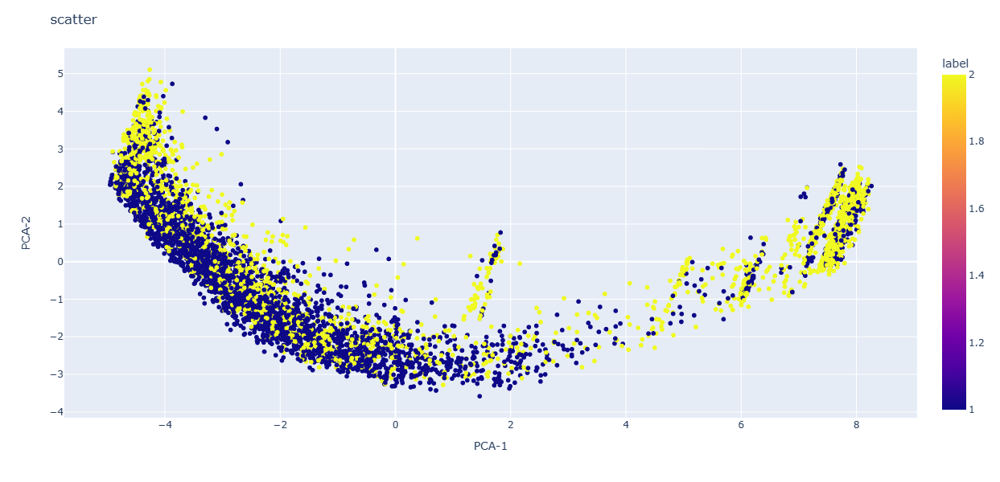

In [40]:
scatter_pca(df_pca)

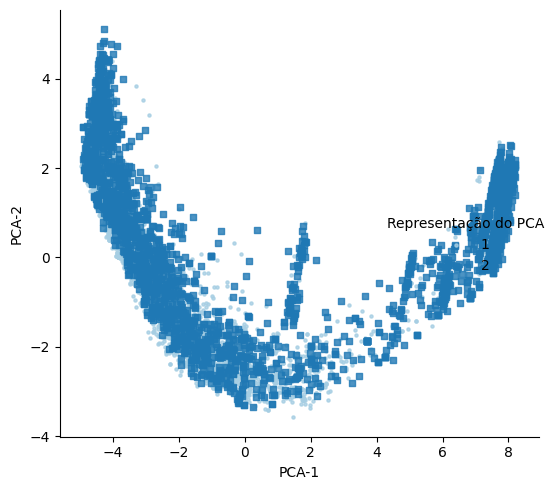

In [41]:
plot_pca_features(
    x_data=df_data.iloc[df_malware[query].index], 
    y_data=df_malware[query]['ID_FAMILY'], 
    classes=[1,2])

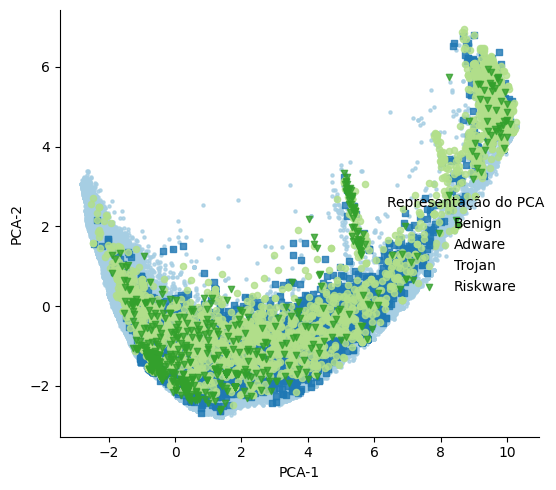

In [41]:
query = df_malware['ID_FAMILY'].isin([1, 2, 3]) # 4 is for test

plot_pca_features(
    x_data= pd.concat([df_data.iloc[df_benign.index] , df_data.iloc[df_malware[query].index] ]), 
    y_data=pd.concat( [df_benign['ID_FAMILY'], df_malware[query]['ID_FAMILY']]), 
    classes=classes_names)

# VT Metadata

In [7]:
def remove_oldest_duplicates(df, date_column, column_to_check):
    # Sort the DataFrame by the date column in ascending order
    df_sorted = df.sort_values(by=date_column)
    
    # Keep track of unique values encountered so far
    unique_values = set()
    
    # Keep track of the index of rows to remove
    rows_to_remove = []
    
    # Iterate over rows
    for index, row in tqdm(df_sorted.iterrows()):
        value = row[column_to_check]
        # If the value is already encountered, mark this row for removal
        if value in unique_values:
            rows_to_remove.append(index)
        else:
            # Otherwise, add it to the set of unique values
            unique_values.add(value)
    
    # Remove the rows marked for removal
    cleaned_df = df_sorted.drop(rows_to_remove)
    
    return cleaned_df

In [9]:
vt_metadata = pd.read_csv(
    join(paths['datasets'], 'amexplorer', 'raw', 'VT_metadata.csv'), 
    sep=',', 
    # nrows=1,
    # usecols=['VT_SCANNERS']

)  

In [10]:
vt_metadata

,VT_LAST_ANALYSIS_DATE,VT_SIZE,SHA256,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES
0,2023-08-15 02:57:24,11779531.0,FC719BF50C24611560B62E4180B8D33F7B16B23E202428...,463c2d758db2eef7b63f1de5b72a8549,1,2,0,62,NaN,[]
1,2023-12-04 11:45:56,18648.0,F382DEA734524116DC4F0302775D9FA1FDA87352DEE413...,d8f01023a5be4e3e1a4479097d009a67,46,0,37,28,trojan.dougalek/douga,"['Lionic', 'DrWeb', 'CAT-QuickHeal', 'Skyhigh'..."
2,2023-10-24 09:23:48,5800181.0,FA2E0B50AA3E0B6C5D93C5C0310956781A16E4D23C6967...,f74b91bc558ce25c68a4c836fad0e1bf,1,0,4,61,NaN,"['VirIT', 'SymantecMobileInsight', 'TrendMicro..."
3,2023-08-06 13:15:27,25179527.0,FF081971B43BBBD2FAD920BDF347AB28E05B4280E6F67F...,111b917fb0fd49dd12c97867c8909e70,1,0,13,51,trojan.jiagu,"['Trustlook', 'K7GW', 'Cyren', 'SymantecMobile..."
4,2023-12-22 06:22:21,9924090.0,F550E067DB5CAAFF7763B3D5005238249B96131FBA40F2...,a381c7c9541790c09acb21a895d5c6ba,2,0,0,66,NaN,[]
...,...,...,...,...,...,...,...,...,...,...
2547895,2023-10-30 21:54:19,2586405.0,FAE723D09B71A8F9B19C20932A8B0284008123439A6938...,05829911ed381fde5a4bf5eb8cdf0065,1,0,0,65,NaN,[]
2547896,2021-12-17 07:33:25,13686313.0,F154DAACD52CD017627A1C9B95FCA48E001797647B6881...,f98bebbcfb17229685406401f58550c1,1,0,1,60,NaN,['MaxSecure']
2547897,2023-10-07 08:19:19,12383884.0,F8403806DA07476B1EF8078263E894D4C0C30FBE583F55...,8424edf9d3651ce415710568b34bacd9,7,0,33,33,adware.ganlet/domob,"['Lionic', 'CAT-QuickHeal', 'Skyhigh', 'McAfee..."
2547898,2023-07-28 12:04:16,17473617.0,FE5FA70BE3084C9B664F74D34CAC1790806421997667D7...,c580231af0a7f07690f55434acdb8f84,1,0,0,58,NaN,[]


In [11]:
vt_metadata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2547900 entries, 0 to 2547899
Data columns (total 10 columns):
 #   Column                              Dtype  
---  ------                              -----  
 0   VT_LAST_ANALYSIS_DATE               object 
 1   VT_SIZE                             float64
 2   SHA256                              object 
 3   VT_MD5                              object 
 4   VT_TIMES_SUBMITTED                  int64  
 5   VT_SCANNERS_FAILURE                 int64  
 6   VT_SCANNERS_MALICIOUS               int64  
 7   VT_SCANNERS_UNDETECTED              int64  
 8   VT_SCANNERS_SUGGESTED_THREAT_LABEL  object 
 9   VT_SCANNERS_NAMES                   object 
dtypes: float64(1), int64(4), object(5)
memory usage: 194.4+ MB


In [12]:
metadata = remove_oldest_duplicates(df=vt_metadata, date_column='VT_LAST_ANALYSIS_DATE', column_to_check='SHA256')
metadata

2547900it [01:21, 31362.95it/s]


,VT_LAST_ANALYSIS_DATE,VT_SIZE,SHA256,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES
1315389,2011-11-09 11:39:17,258722.0,F307CF2A9DABE54258BBEBC42CFADF0FE253F3C0C64BCB...,4634b8678595cafd473f2a86c373136b,2,0,0,42,NaN,[]
2530688,2011-11-09 11:40:15,603866.0,F91D2D8A61702223B49230C522E626E011FB1FB0F4AADD...,5ff0e820662c709113d0243055615e37,2,0,0,42,NaN,[]
965246,2012-02-10 20:32:31,6550735.0,FFD35BDDBCBD38FEEDCEC55A4EDFBFE6060E532AEBD100...,e0b13ce33128f5570279fc82a470ae07,1,0,0,42,NaN,[]
26485,2012-02-10 20:33:01,4371678.0,FF80BACF79EE1367549B4FB832302A9B67DA0B0C993B9F...,321ae5d42df825da5dbdf1d84e25012b,1,0,0,42,NaN,[]
696878,2012-02-10 20:33:14,4289317.0,FF3BD6FD4BF013AE0F486B95382AC9880B4303EB12B260...,98ef9338e4f328aa70034dcadc224563,1,0,0,42,NaN,[]
...,...,...,...,...,...,...,...,...,...,...
963707,2023-12-25 15:48:23,18485925.0,F5DDA18F7BF8B839687B40AC545ABD3A61DFB5635B7ADB...,7f0a9a2dffae9597b87012fbca2045b5,3,5,0,49,NaN,[]
26551,2023-12-25 19:16:48,24612798.0,F5C7A8248AF58B59BEC8735624010A208F985B4A4CEE6D...,a026319bd2c08060f3ad4ae28e3122c3,1,0,0,64,NaN,[]
1376158,2023-12-26 15:31:30,34739846.0,F5DA63CE35D5DB74D14D766E824F52532B6F4AC9E04567...,016da95b615c1303346052bf1d66c4a2,1,0,0,57,NaN,[]
49672,2023-12-26 15:35:09,40285339.0,F5C8BFB85757C7FE34D896DED499EE08211F49B4C37E45...,82f2688bf9ef472c29583a7bd2bdb0f1,6,0,0,53,NaN,[]


In [32]:
meta = dataframe()
meta['VT_LAST_ANALYSIS_DATE'] = metadata['VT_LAST_ANALYSIS_DATE'].astype('string')
meta['VT_SIZE'] = metadata['VT_SIZE'].astype(np.float32)
meta['SHA256'] = metadata['SHA256'].astype('string')
meta['VT_MD5'] = metadata['VT_MD5'].astype('string')
meta['VT_TIMES_SUBMITTED'] = metadata['VT_TIMES_SUBMITTED'].astype(np.int8)
meta['VT_SCANNERS_FAILURE'] = metadata['VT_SCANNERS_FAILURE'].astype(np.int8)
meta['VT_SCANNERS_MALICIOUS'] = metadata['VT_SCANNERS_MALICIOUS'].astype(np.int8)
meta['VT_SCANNERS_UNDETECTED'] = metadata['VT_SCANNERS_UNDETECTED'].astype(np.int8)
meta['VT_SCANNERS_SUGGESTED_THREAT_LABEL'] = metadata['VT_SCANNERS_SUGGESTED_THREAT_LABEL'].astype('string')
meta['VT_SCANNERS_NAMES'] = metadata['VT_SCANNERS_NAMES'].astype('string')
meta.reset_index(drop=True)

,VT_LAST_ANALYSIS_DATE,VT_SIZE,SHA256,VT_MD5,VT_TIMES_SUBMITTED,VT_SCANNERS_FAILURE,VT_SCANNERS_MALICIOUS,VT_SCANNERS_UNDETECTED,VT_SCANNERS_SUGGESTED_THREAT_LABEL,VT_SCANNERS_NAMES
0,2011-11-09 11:39:17,258722.0,F307CF2A9DABE54258BBEBC42CFADF0FE253F3C0C64BCB...,4634b8678595cafd473f2a86c373136b,2,0,0,42,<NA>,[]
1,2011-11-09 11:40:15,603866.0,F91D2D8A61702223B49230C522E626E011FB1FB0F4AADD...,5ff0e820662c709113d0243055615e37,2,0,0,42,<NA>,[]
2,2012-02-10 20:32:31,6550735.0,FFD35BDDBCBD38FEEDCEC55A4EDFBFE6060E532AEBD100...,e0b13ce33128f5570279fc82a470ae07,1,0,0,42,<NA>,[]
3,2012-02-10 20:33:01,4371678.0,FF80BACF79EE1367549B4FB832302A9B67DA0B0C993B9F...,321ae5d42df825da5dbdf1d84e25012b,1,0,0,42,<NA>,[]
4,2012-02-10 20:33:14,4289317.0,FF3BD6FD4BF013AE0F486B95382AC9880B4303EB12B260...,98ef9338e4f328aa70034dcadc224563,1,0,0,42,<NA>,[]
...,...,...,...,...,...,...,...,...,...,...
1342034,2023-12-25 15:48:23,18485924.0,F5DDA18F7BF8B839687B40AC545ABD3A61DFB5635B7ADB...,7f0a9a2dffae9597b87012fbca2045b5,3,5,0,49,<NA>,[]
1342035,2023-12-25 19:16:48,24612798.0,F5C7A8248AF58B59BEC8735624010A208F985B4A4CEE6D...,a026319bd2c08060f3ad4ae28e3122c3,1,0,0,64,<NA>,[]
1342036,2023-12-26 15:31:30,34739848.0,F5DA63CE35D5DB74D14D766E824F52532B6F4AC9E04567...,016da95b615c1303346052bf1d66c4a2,1,0,0,57,<NA>,[]
1342037,2023-12-26 15:35:09,40285340.0,F5C8BFB85757C7FE34D896DED499EE08211F49B4C37E45...,82f2688bf9ef472c29583a7bd2bdb0f1,6,0,0,53,<NA>,[]


In [33]:
meta.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1342039 entries, 1315389 to 1326656
Data columns (total 10 columns):
 #   Column                              Non-Null Count    Dtype  
---  ------                              --------------    -----  
 0   VT_LAST_ANALYSIS_DATE               1342039 non-null  string 
 1   VT_SIZE                             1342028 non-null  float32
 2   SHA256                              1342039 non-null  string 
 3   VT_MD5                              1342028 non-null  string 
 4   VT_TIMES_SUBMITTED                  1342039 non-null  int8   
 5   VT_SCANNERS_FAILURE                 1342039 non-null  int8   
 6   VT_SCANNERS_MALICIOUS               1342039 non-null  int8   
 7   VT_SCANNERS_UNDETECTED              1342039 non-null  int8   
 8   VT_SCANNERS_SUGGESTED_THREAT_LABEL  111741 non-null   string 
 9   VT_SCANNERS_NAMES                   1342039 non-null  string 
dtypes: float32(1), int8(4), string(5)
memory usage: 71.7 MB


In [39]:
meta.to_csv(join(paths['data'], 'amex', 'metadata-filtered.csv'))

In [ ]:
# Merge the two DataFrames based on the common column
merged_df = pd.merge(df1, df2, on='common_column', how='inner')

# 'how' parameter determines the type of join:
# - 'inner': Only include observations found in both DataFrames
# - 'left': Use only keys from the left DataFrame, similar to a SQL left outer join
# - 'right': Use only keys from the right DataFrame, similar to a SQL right outer join
# - 'outer': Use union of keys from both DataFrames, similar to a SQL full outer join


# Training

In [42]:
import xgboost
print(xgboost.__version__)
from xgboost import XGBClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn import metrics
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.inspection import permutation_importance
from sklearn.preprocessing import OneHotEncoder

1.7.5


In [ ]:
import evaluation
import importlib
importlib.reload(evaluation)

## Malware Family classifier

In [51]:
le = LabelEncoder().fit(df_malware['ID_FAMILY'])

## Add families
query = df_malware['ID_FAMILY'].isin([1, 2, 3]) # 4 is for test

data_malware = {
    'X_train' : df_data.iloc[df_malware[query].index],
    'y_train': le.transform( df_malware [query]['ID_FAMILY']),
    'X_val': df_data.iloc[df_malware[~query].index],
    'y_val': le.transform(df_malware [~query]['ID_FAMILY']),
    'classes_names': ['Adware', 'Trojan', 'Riskware'],
    'classes_names_id': [1, 2, 3]
}

In [161]:

X_train, X_test, y_train, y_test = train_test_split(
    np.expand_dims(data_malware['X_train'].values, 2), 
    data_malware['y_train'], 
    test_size=0.15, 
    random_state=0, 
    shuffle=True)


print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

ohe = OneHotEncoder()
ohe.fit(np.expand_dims(y_train, 1))
y_train_ohe = ohe.transform(np.expand_dims(y_train, 1)).toarray()
y_test_ohe = ohe.transform(np.expand_dims(y_test, 1)).toarray()

(6594, 708, 1) (1164, 708, 1) (6594,) (1164,)


In [112]:
y_test_ohe

array([[1., 0., 0.],
       [0., 1., 0.],
       [0., 1., 0.],
       ...,
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 1., 0.]])

### Traditional Classifier

In [173]:
model, y_pred, cm, report = evaluation.train(
    x_train=X_train.squeeze(), 
    y_train=y_train, 
    x_test=X_test.squeeze(), 
    y_test=y_test,
    class_names=data_malware['classes_names'], 
    classifier='xgboost')

xgboost
training
predict
evaluation
Accuracy: 0.7216494845360825
Confusion matrix: 0.7216494845360825
Generating reports
              precision    recall  f1-score   support

      Adware       0.73      0.83      0.78       592
      Trojan       0.72      0.67      0.69       469
    Riskware       0.68      0.31      0.43       103

    accuracy                           0.72      1164
   macro avg       0.71      0.60      0.63      1164
weighted avg       0.72      0.72      0.71      1164



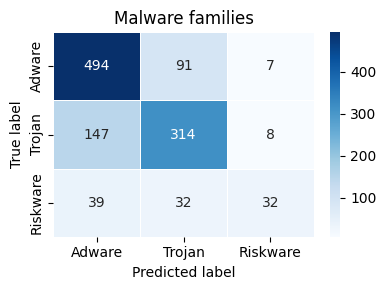

In [174]:
fig= plt.figure(figsize=(4, 3))
sns.heatmap(cm, annot=True, cmap='Blues', linewidth=.5, fmt="g") # fmt=".1f")

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.title('Malware families')
plt.xticks(ticks=[.5, 1.5, 2.5], labels = data_malware['classes_names'])
plt.yticks(ticks=[.5, 1.5, 2.5], labels = data_malware['classes_names'])
plt.tight_layout()

### Explanation

In [201]:
explainer, shap_values = shap_explainer(model, X_test.squeeze(), y_test, explainer_name='TreeExplainer')

 98%|===================| 3419/3492 [00:28<00:00]        

In [214]:
# plt_beeswarm_custom(
#     shap_values=shap_values[:,:,1], 
#     max_display=30, 
#     figsize=(8,4), 
#     path_save=[], 
#     title='')

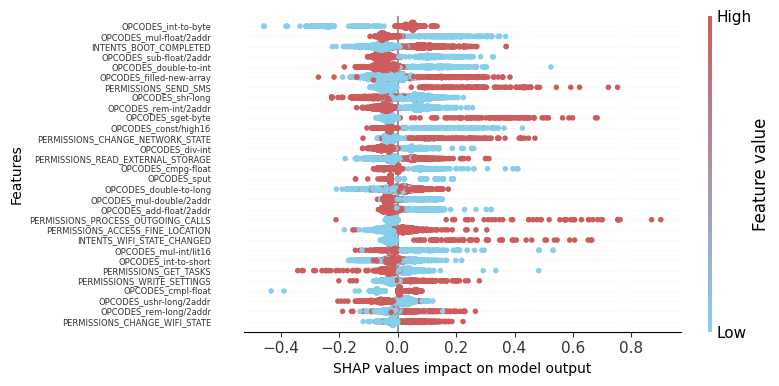

In [212]:
plt_summary_custom(
    shap_values=shap_values[:,:,1], X=X_test.squeeze(), 
    max_display=30, feature_names=df_data.columns.values, 
    figsize=(8,4), path_save=[], title='XGBoost',
    plot_type = 'dot'
)

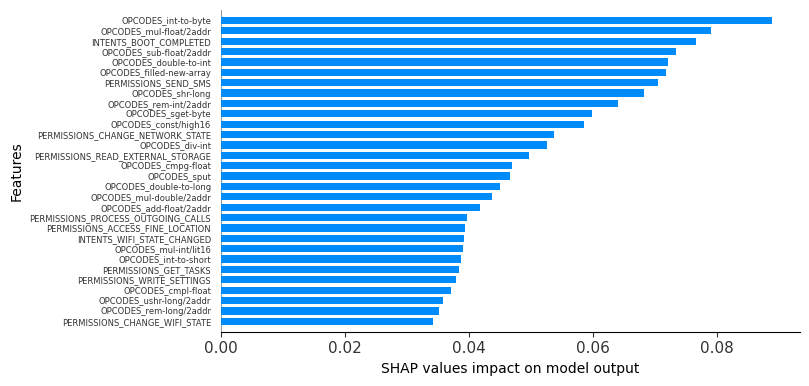

In [213]:
plt_summary_custom(
    shap_values=shap_values[:,:,1], X=X_test.squeeze(), 
    max_display=30, feature_names=df_data.columns.values, 
    figsize=(8,4), path_save=[], title='XGBoost',
    plot_type = 'bar'
)

## CNN Classifier

In [138]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense, BatchNormalization, Dropout, GlobalAveragePooling1D
from tensorflow.keras import optimizers
from tensorflow.keras import callbacks
from tensorflow.keras.models import Model

import tensorflow_addons as tfa
from tensorflow.keras.utils import plot_model
# from sklearn.preprocessing import OneHotEncoder

from tensorflow.keras.models import load_model, save_model

from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())
# tf_device="GPU:0"
# !nvidia-smi

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 1934300264503252614
xla_global_id: -1
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 22722641920
locality {
  bus_id: 1
  links {
  }
}
incarnation: 17776959458681809747
physical_device_desc: "device: 0, name: NVIDIA GeForce RTX 3090, pci bus id: 0000:09:00.0, compute capability: 8.6"
xla_global_id: 416903419
]


In [103]:
def conv1d(input_shape, num_classes):
    model = Sequential([
        # First 1D convolutional layer
        Conv1D(filters=64, kernel_size=3, input_shape=input_shape, padding='same'),
        BatchNormalization(),
        tf.keras.layers.ReLU(),
        MaxPooling1D(pool_size=2),
        Dropout(0.1),
        
        # Second 1D convolutional layer
        Conv1D(filters=64, kernel_size=3, padding='same'),
        BatchNormalization(),
        tf.keras.layers.ReLU(),
        MaxPooling1D(pool_size=2),
        Dropout(0.1),
        
        # Third 1D convolutional layer
        Conv1D(filters=64, kernel_size=3, padding='same'),
        BatchNormalization(),
        tf.keras.layers.ReLU(),
        MaxPooling1D(pool_size=2),
        Dropout(0.1),
        
        # Flatten the output to feed into a dense layer
        # Flatten(),
        GlobalAveragePooling1D(),
        
        # Dense layer acting as an embedded layer
        Dense(128, activation='relu', name='embedded_layer'),
        Dropout(0.1),
        
        # Output layer for classification
        Dense(num_classes, activation='softmax')
    ])
    
    model.compile(optimizer='adam',
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])
    
    return model


def simple_cnn(input_shape,  num_classes):
    input_= layers.Input(input_shape)

    conv = layers.Conv1D(filters=64, kernel_size=3, strides=1, padding='same', name='conv_4')(conv)
    conv = layers.MaxPooling1D(pool_size=2)(conv)
    conv = layers.BatchNormalization()(conv)
    conv = layers.Activation('relu')(conv)

    conv = layers.Conv1D(filters=64, kernel_size=3, strides=1, padding='same', name='conv_4')(conv)
    conv = layers.MaxPooling1D(pool_size=2)(conv)
    conv = layers.BatchNormalization()(conv)
    conv = layers.Activation('relu')(conv)

    conv = layers.Conv1D(filters=64, kernel_size=3, strides=1, padding='same', name='conv_4')(conv)
    conv = layers.MaxPooling1D(pool_size=2)(conv)
    conv = layers.BatchNormalization()(conv)
    conv = layers.Activation('relu')(conv)
    conv = layers.Dropout(0.1)

    gap_layer = layers.GlobalAveragePooling1D(name='GAP')(conv)

    # dense_layer = layers.Dense(16, activation='relu', name='dense_layer')(gap_layer)
    out = layers.Dense(num_classes, activation='softmax', name='predictions')(gap_layer)

    return tf.keras.models.Model(inputs=input_, outputs=out)

def load_callbacks(path):
      
    loss = callbacks.ModelCheckpoint(path+'_loss.h5', save_best_only=True, monitor='val_loss', mode='min', verbose=2)
    acc = callbacks.ModelCheckpoint(path+'_acc.h5',save_best_only=True, monitor='val_accuracy', mode='max', verbose=2)
    f1 = callbacks.ModelCheckpoint(path+'_f1.h5', save_best_only=True, monitor='val_f1_score', mode='max', verbose=2)
    history = callbacks.CSVLogger(path+'_history.csv')
    
    return [acc, loss, f1, history]


# # Example usage:
# input_shape = (28, 28, 1) # For grayscale images of size 28x28 pixels
# num_classes = 10 # For example, 10 classes for digit classification (0-9)

# model = create_conv_net(input_shape, num_classes)
# model.summary()

# # To access the embedded layer specifically, you can do:
# embedded_layer = model.get_layer('embedded_layer')

In [117]:
print(X_train.shape)

input_shape = (X_train.shape[1], 1)
print(input_shape)
# class_names = np.unique(dataset['DS1']['labels'])
# class_names = np.unique(y_train)
print(malware_classes)


f1__ = tfa.metrics.F1Score(num_classes= len(malware_classes), average='macro')

(6594, 708)
(708, 1)
['Adware', 'Trojan', 'Riskware']


In [59]:
print(os.getcwd())

model_name = 'Amex-malware-cnn-classifier'
print(model_name)

path = join(paths['models'], model_name)
print(path)

D:\github
Amex-malware-cnn-classifier
D:\github\models\Amex-malware-cnn-classifier


### train

In [118]:
with tf.device('/gpu:0'):
    model = conv1d(input_shape=input_shape,  num_classes=3)

    model.compile(
        loss="categorical_crossentropy",
        optimizer=optimizers.Adam(learning_rate=1e-4),
        metrics=["accuracy"],
    )
    model.summary() 

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_30 (Conv1D)          (None, 708, 64)           256       
                                                                 
 batch_normalization_30 (Bat  (None, 708, 64)          256       
 chNormalization)                                                
                                                                 
 re_lu_30 (ReLU)             (None, 708, 64)           0         
                                                                 
 max_pooling1d_30 (MaxPoolin  (None, 354, 64)          0         
 g1D)                                                            
                                                                 
 dropout_40 (Dropout)        (None, 354, 64)           0         
                                                                 
 conv1d_31 (Conv1D)          (None, 354, 64)         

In [115]:
X_train.shape, y_train_ohe.shape

((6594, 708), (6594, 3))

In [119]:
# tf.config.run_functions_eagerly(True)

with tf.device('/gpu:0'):

    history = model.fit(
        # X_train,
        np.expand_dims(X_train, axis=2),
        y_train_ohe,
        validation_split=0.2,
        epochs=500,
        batch_size=32,
        callbacks= load_callbacks(path)
    )

Epoch 1/500
165/165 [==============================] - ETA: 0s - loss: 0.8728 - accuracy: 0.6118
Epoch 1: val_accuracy improved from -inf to 0.53374, saving model to D:\github\models\Amex-malware-cnn-classifier_acc.h5

Epoch 1: val_loss improved from inf to 0.99995, saving model to D:\github\models\Amex-malware-cnn-classifier_loss.h5
165/165 [==============================] - 3s 13ms/step - loss: 0.8728 - accuracy: 0.6118 - val_loss: 0.9999 - val_accuracy: 0.5337
Epoch 2/500
162/165 [============================>.] - ETA: 0s - loss: 0.8329 - accuracy: 0.6366
Epoch 2: val_accuracy did not improve from 0.53374

Epoch 2: val_loss improved from 0.99995 to 0.97278, saving model to D:\github\models\Amex-malware-cnn-classifier_loss.h5
165/165 [==============================] - 2s 12ms/step - loss: 0.8327 - accuracy: 0.6366 - val_loss: 0.9728 - val_accuracy: 0.5337
Epoch 3/500
163/165 [============================>.] - ETA: 0s - loss: 0.8277 - accuracy: 0.6392
Epoch 3: val_accuracy improved fr

### show results

In [121]:
# name__ = 'MH-100K'

best_model = tf.keras.models.load_model(join(paths['models'], model_name+'_loss.h5'))

In [125]:
scores = best_model.evaluate(np.expand_dims(X_test, axis=2), y_test_ohe)

37/37 [==============================] - 0s 8ms/step - loss: 0.6906 - accuracy: 0.7113


In [126]:
y_pred = model.predict(np.expand_dims(X_test, axis=2))
y_pred_class = np.argmax(y_pred, axis=1)

37/37 [==============================] - 0s 5ms/step


In [127]:
cm = confusion_matrix(y_test, y_pred_class)
print(cm)

[[507  69  16]
 [170 277  22]
 [ 41  25  37]]


In [130]:
malware_classes

['Adware', 'Trojan', 'Riskware']

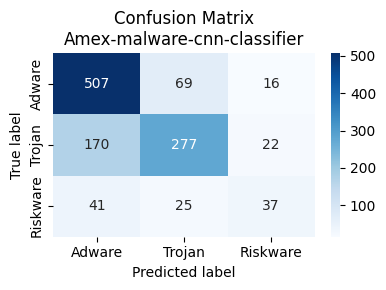

In [133]:
figure = plt.figure(figsize=(4, 3))
sns.heatmap(cm, annot=True, cmap=plt.cm.Blues, fmt='g')
plt.tight_layout()
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.title('Confusion Matrix\n'+model_name)
plt.xticks(ticks=[.5, 1.5, 2.5], labels = malware_classes)
plt.yticks(ticks=[.5, 1.5, 2.5], labels = malware_classes)
plt.tight_layout()
plt.savefig(join(paths['models'], model_name+'_cm.png'), format='png')

In [135]:
report = classification_report(y_true=y_test, y_pred=y_pred_class, target_names=malware_classes)
print(report)

              precision    recall  f1-score   support

      Adware       0.71      0.86      0.77       592
      Trojan       0.75      0.59      0.66       469
    Riskware       0.49      0.36      0.42       103

    accuracy                           0.71      1164
   macro avg       0.65      0.60      0.62      1164
weighted avg       0.70      0.71      0.70      1164



In [136]:
import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

def plot_embeddings(embeddings, labels):
    """
    Plots 2D t-SNE embeddings of the data.
    
    :param embeddings: Numpy array of embeddings
    :param labels: Numpy array of labels corresponding to the embeddings
    """
    # Perform t-SNE dimensionality reduction
    tsne = TSNE(n_components=2, random_state=42)
    reduced_embeddings = tsne.fit_transform(embeddings)
    
    # Plot the reduced embeddings
    plt.figure(figsize=(10, 10))
    unique_labels = np.unique(labels)
    for label in unique_labels:
        # Filter points by label
        indices = labels == label
        plt.scatter(reduced_embeddings[indices, 0], reduced_embeddings[indices, 1], label=label, alpha=0.5)
    
    plt.xlabel("t-SNE dimension 1")
    plt.ylabel("t-SNE dimension 2")
    plt.title("t-SNE Plot of Embeddings")
    plt.legend(markerscale=2)
    plt.grid(True)
    plt.show()

In [139]:
embedding_model = Model(inputs=best_model.input, outputs=best_model.get_layer('embedded_layer').output)
embeddings = embedding_model.predict(np.expand_dims(X_train, axis=2))

207/207 [==============================] - 1s 2ms/step


The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.


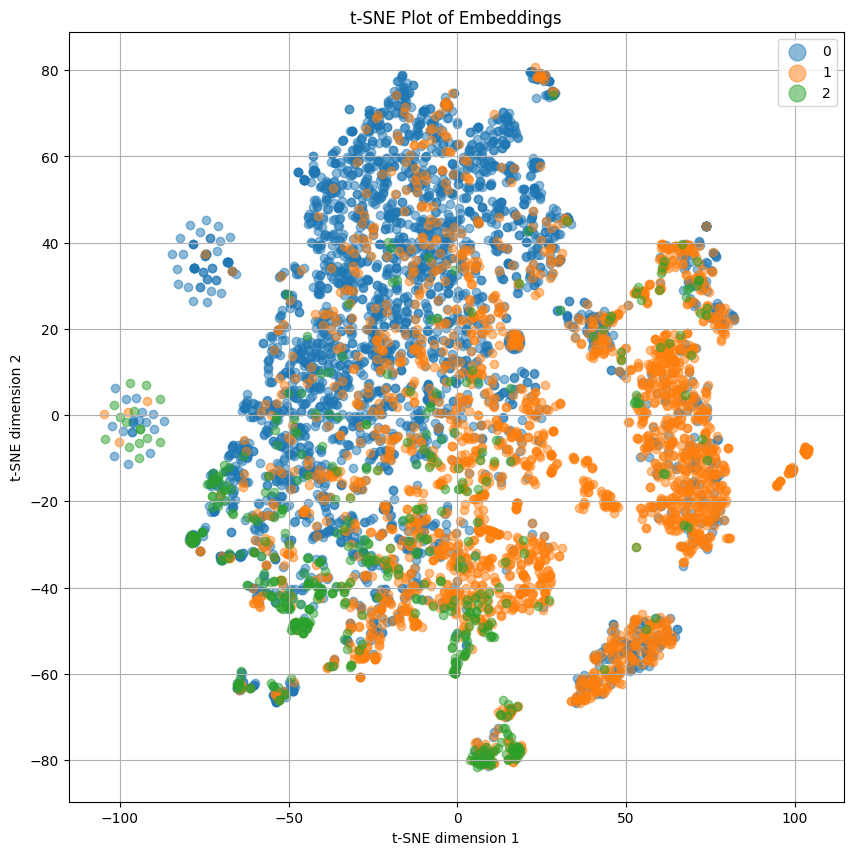

In [141]:
plot_embeddings(embeddings=embeddings, labels=y_train)

### Explanations

In [218]:
import shap

shap.explainers._deep.deep_tf.op_handlers["AddV2"] = shap.explainers._deep.deep_tf.passthrough

In [ ]:
# masker = shap.maskers.Independent(X_test)
explainer_dn = shap.DeepExplainer(best_model, masker.data)

shap_values_dn = explainer_dn.shap_values(X_test)

In [ ]:
explainer_dn = shap.DeepExplainer(best_model, masker.data)

shap_values_dn = explainer_dn.shap_values(X_test)

In [215]:
explainer, shap_values = shap_explainer(best_model, np.expand_dims(X_test, axis=2), y_test_ohe, explainer_name='DeepExplainer')

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


AttributeError: 'Deep' object has no attribute 'masker'

## Malware Binary Classifier

### Train and Test Split

In [310]:
## Split dataset
# dataset_dict = {'X_train': [], 'X_test': [], 'y_train': [], 'y_test': []}

X_train, X_test, y_train, y_test = train_test_split(
    df_data.values, 
    df_metadata.LABELS, 
    test_size=0.15, 
    random_state=0, 
    shuffle=True)

print(X_Train.shape, X_test.shape, y_train.shape, y_test.shape)

(85797, 708) (15141, 708) (85797,) (15141,)


In [304]:
df_metadata.LABELS.value_counts(), np.unique(y_train, return_counts=True), np.unique(y_test, return_counts=True)

(0    92384
 1     8554
 Name: LABELS, dtype: int64,
 (array([0, 1]), array([78562,  7235], dtype=int64)),
 (array([0, 1]), array([13822,  1319], dtype=int64)))

In [311]:
model, y_pred, cm, report = evaluation.train(X_train, y_train, X_test, y_test, class_names=class_names, classifier='xgboost')

xgboost
training
predict
evaluation
Accuracy: 0.9711379697510072
Confusion matrix: 0.9711379697510072
Generating reports
              precision    recall  f1-score   support

      benign       0.98      0.99      0.98     13822
     malware       0.90      0.75      0.82      1319

    accuracy                           0.97     15141
   macro avg       0.94      0.87      0.90     15141
weighted avg       0.97      0.97      0.97     15141



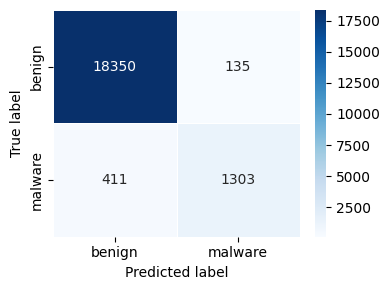

In [15]:
evaluation.plot_cm(cm=cm, class_names=class_names)

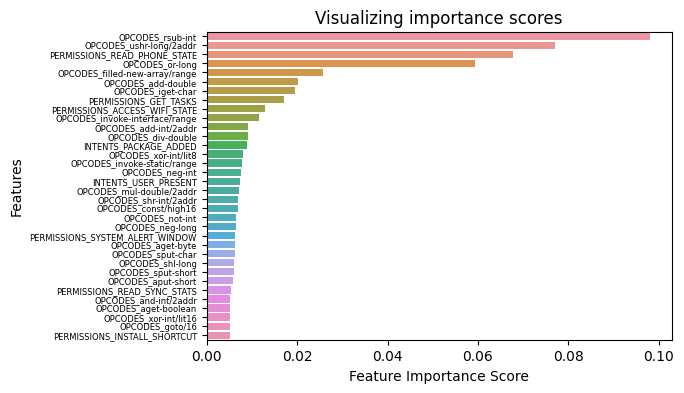

In [69]:
feat_importances = evaluation.plot_importance(model, feature_names=column_names, threshold=0.005, figsize=(6, 4))

In [55]:
explainer, shap_values = evaluation.shap_explainer(model, X_val, y_val)

 99%|===================| 20062/20199 [00:49<00:00]        

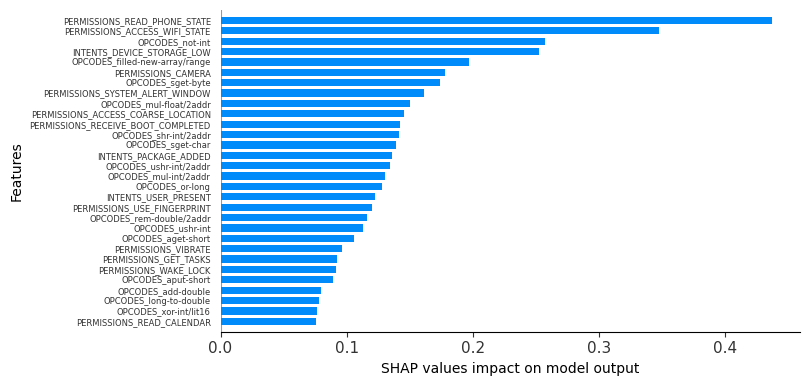

In [66]:
evaluation.plt_summary_custom(
    shap_values=shap_values, X=X_val, 
    max_display=30, feature_names=column_names, 
    figsize=(8,4), path_save=paths['images'], 
    title='binary_100K_per_int_opc',
    plot_type = 'bar'
)

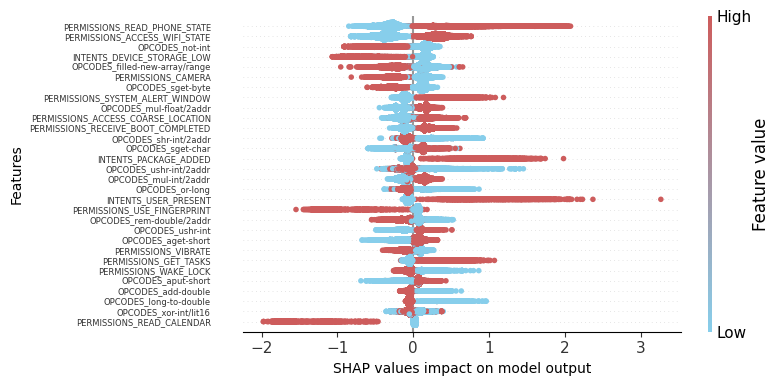

In [67]:
evaluation.plt_summary_custom(
    shap_values=shap_values, X=X_val, 
    max_display=30, feature_names=column_names, 
    figsize=(8,4), 
    path_save=None, 
    title='binary_100K_per_int_opc',
    plot_type = 'dot'
)

In [ ]:
evaluation.plt_beeswarm_custom(
    shap_values=shap_values, 
    max_display=30, 
    figsize=(5,3), 
    path_save=None, 
    title='binary_100K_per_int_opc')